In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error, \
    median_absolute_error, mean_squared_error, mean_squared_log_error

import warnings
warnings.filterwarnings("ignore")

In [3]:
import plotly.express as px

In [4]:
!pip install scikit-learn

In [5]:
!pip install ucimlrepo

In [6]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
metro_interstate_traffic_volume = fetch_ucirepo(id=492)

# data (as pandas dataframes)
X = metro_interstate_traffic_volume.data.features
y = metro_interstate_traffic_volume.data.targets

# metadata
print(metro_interstate_traffic_volume.metadata)

# variable information
print(metro_interstate_traffic_volume.variables)

{'uci_id': 492, 'name': 'Metro Interstate Traffic Volume', 'repository_url': 'https://archive.ics.uci.edu/dataset/492/metro+interstate+traffic+volume', 'data_url': 'https://archive.ics.uci.edu/static/public/492/data.csv', 'abstract': 'Hourly Minneapolis-St Paul, MN traffic volume for westbound I-94. Includes weather and holiday features from 2012-2018.', 'area': 'Other', 'tasks': ['Regression'], 'characteristics': ['Multivariate', 'Sequential', 'Time-Series'], 'num_instances': 48204, 'num_features': 8, 'feature_types': ['Integer', 'Real'], 'demographics': [], 'target_col': ['traffic_volume'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 2019, 'last_updated': 'Fri Mar 15 2024', 'dataset_doi': '10.24432/C5X60B', 'creators': ['John Hogue'], 'intro_paper': None, 'additional_info': {'summary': 'Hourly Interstate 94 Westbound traffic volume for MN DoT ATR station 301, roughly midway between Minneapolis and St Paul, MN. Hourly weath

## 1. EDA

In [ ]:
X.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time
0,NaN,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00
1,NaN,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00
2,NaN,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00
3,NaN,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00
4,NaN,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00


In [ ]:
y.head()

,traffic_volume
0,5545
1,4516
2,4767
3,5026
4,4918


In [7]:
x_full = X.merge(y, left_index=True, right_index=True)
x_full.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,NaN,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,NaN,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,NaN,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,NaN,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,NaN,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [8]:
#оставляем только необходимые колонки
df_x = x_full.copy()
df_x.drop(columns =['rain_1h', 'snow_1h', 'weather_main', 'weather_description', 'clouds_all'], inplace=True)

In [8]:
df_h = df_x.copy()

In [9]:
df_x.head()

,holiday,temp,date_time,traffic_volume
0,NaN,288.28,2012-10-02 09:00:00,5545
1,NaN,289.36,2012-10-02 10:00:00,4516
2,NaN,289.58,2012-10-02 11:00:00,4767
3,NaN,290.13,2012-10-02 12:00:00,5026
4,NaN,291.14,2012-10-02 13:00:00,4918


In [ ]:
df_x.shape

(48204, 4)

In [ ]:
df_x.describe()

,temp,traffic_volume
count,48204.000000,48204.000000
mean,281.205870,3259.818355
std,13.338232,1986.860670
min,0.000000,0.000000
25%,272.160000,1193.000000
50%,282.450000,3380.000000
75%,291.806000,4933.000000
max,310.070000,7280.000000


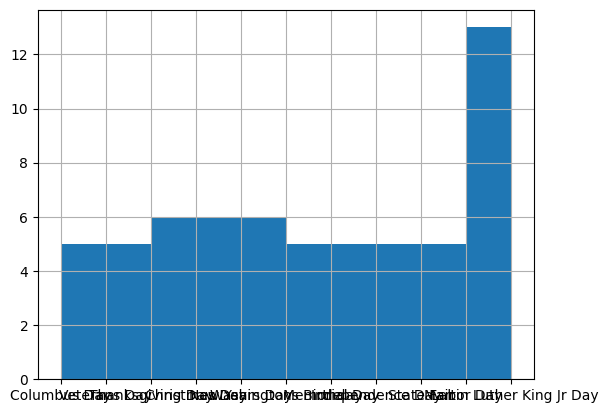

In [ ]:
df_x['holiday'].hist();

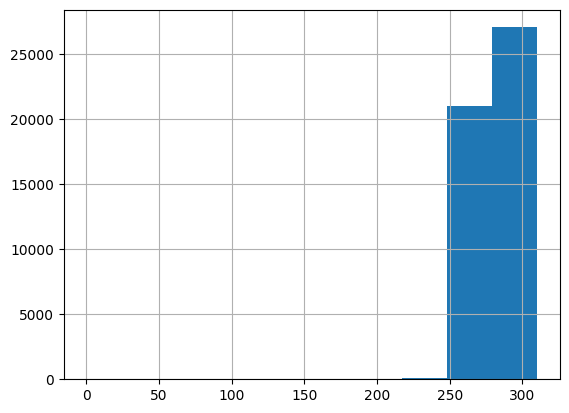

In [ ]:
df_x['temp'].hist();

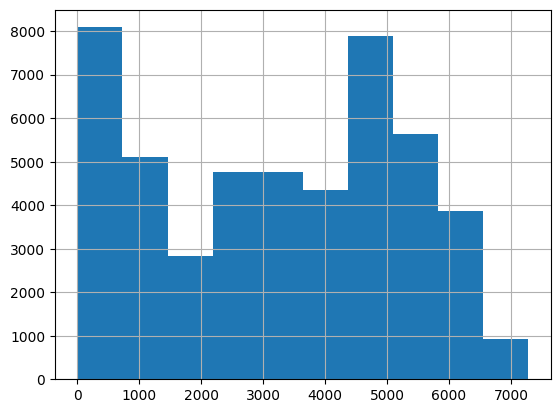

In [ ]:
y['traffic_volume'].hist();

In [ ]:
x1 = df_x.date_time
y1 = y.traffic_volume

fig = px.line(df_x, x1, y1)
fig.show()

In [ ]:
#import plotly.express as px
fig = px.line (df_x, # ts[ts['coin'] == 'bitcoin']
              x="date_time", y=y['traffic_volume'],
              line_shape="spline", #сплайн-аппроксимация
              render_mode="svg", log_y=True)
fig.update_layout(xaxis_title="Дата", yaxis_title="Трафик")

# fig.layout.xaxis.title = 'Название оси'
# fig.layout.yaxis.title = 'Название другой оси'
# fig.layout.title.text = 'Новое название диаграммы'
fig.show()

In [9]:
# удаляем дубликаты
df_un = df_x.drop_duplicates(subset=['date_time'])

In [ ]:
df_un.shape

(40575, 4)

In [ ]:
print(df_un[df_un.date_time.duplicated()].sum)

<bound method DataFrame.sum of Empty DataFrame
Columns: [holiday, temp, date_time, traffic_volume]
Index: []>


#### определим диапазон дат

In [ ]:
## https://sky.pro/wiki/python/reshenie-oshibki-value-error-cannot-reindex-from-a-duplicate-axis-v-pandas/

In [10]:
#устанавливаем date_time в качестве index
df_un.set_index("date_time", inplace=True)

In [11]:
# Преобразование индекса в datetime
df_un.index = pd.to_datetime(df_un.index)

In [12]:
# генерим даты с шагом 1 час исходя от минимального и максимального индекса даты
#date_range1 = pd.date_range(start=df_un.index.min(), end=df_un.index.max(), tz='Europe/Moscow')
date_range = pd.date_range(start=df_un.index.min(), end=df_un.index.max(), freq='1h')
print(date_range)

DatetimeIndex(['2012-10-02 09:00:00', '2012-10-02 10:00:00',
               '2012-10-02 11:00:00', '2012-10-02 12:00:00',
               '2012-10-02 13:00:00', '2012-10-02 14:00:00',
               '2012-10-02 15:00:00', '2012-10-02 16:00:00',
               '2012-10-02 17:00:00', '2012-10-02 18:00:00',
               ...
               '2018-09-30 14:00:00', '2018-09-30 15:00:00',
               '2018-09-30 16:00:00', '2018-09-30 17:00:00',
               '2018-09-30 18:00:00', '2018-09-30 19:00:00',
               '2018-09-30 20:00:00', '2018-09-30 21:00:00',
               '2018-09-30 22:00:00', '2018-09-30 23:00:00'],
              dtype='datetime64[ns]', length=52551, freq='h')


In [13]:
# удаляем дубликаты по индексу-дата  при этом осталяем последнее актуальное значение по дубликатам
df_un = df_un.loc[~df_un.index.duplicated(keep='last')]

In [14]:
# (keep='last')].reindex(date_range1, fill_value=0
# заполняем данные
df_ready = df_un.reindex(date_range)
print(df_ready)

                    holiday    temp  traffic_volume
2012-10-02 09:00:00     NaN  288.28          5545.0
2012-10-02 10:00:00     NaN  289.36          4516.0
2012-10-02 11:00:00     NaN  289.58          4767.0
2012-10-02 12:00:00     NaN  290.13          5026.0
2012-10-02 13:00:00     NaN  291.14          4918.0
...                     ...     ...             ...
2018-09-30 19:00:00     NaN  283.45          3543.0
2018-09-30 20:00:00     NaN  282.76          2781.0
2018-09-30 21:00:00     NaN  282.73          2159.0
2018-09-30 22:00:00     NaN  282.09          1450.0
2018-09-30 23:00:00     NaN  282.12           954.0

[52551 rows x 3 columns]


In [ ]:
df_ready.shape

(52551, 3)

In [ ]:
# видим, что данных существенно прибавилось

In [ ]:
df_ready.head(5)

,holiday,temp,traffic_volume
2012-10-02 09:00:00,NaN,288.28,5545.0
2012-10-02 10:00:00,NaN,289.36,4516.0
2012-10-02 11:00:00,NaN,289.58,4767.0
2012-10-02 12:00:00,NaN,290.13,5026.0
2012-10-02 13:00:00,NaN,291.14,4918.0


Интерполируем даные

In [15]:
df_full_ready = df_ready.interpolate(method='linear');

In [19]:
df_full_ready.holiday.unique

<bound method Series.unique of 2012-10-02 09:00:00    NaN
2012-10-02 10:00:00    NaN
2012-10-02 11:00:00    NaN
2012-10-02 12:00:00    NaN
2012-10-02 13:00:00    NaN
                      ... 
2018-09-30 19:00:00    NaN
2018-09-30 20:00:00    NaN
2018-09-30 21:00:00    NaN
2018-09-30 22:00:00    NaN
2018-09-30 23:00:00    NaN
Freq: h, Name: holiday, Length: 52551, dtype: object>

In [ ]:
x1 = df_full_ready.index
y1 = df_full_ready.traffic_volume

fig = px.line(df_full_ready, x1, y1)
fig.show()

График не имеет тренда, но ест выбросы.

,temp,traffic_volume
count,52551.000000,52551.000000
mean,282.503180,3071.868385
std,12.991269,1922.655704
min,0.000000,0.000000
25%,273.580000,1223.058955
50%,286.420000,2896.500000
75%,291.703441,4775.000000
max,310.070000,7280.000000


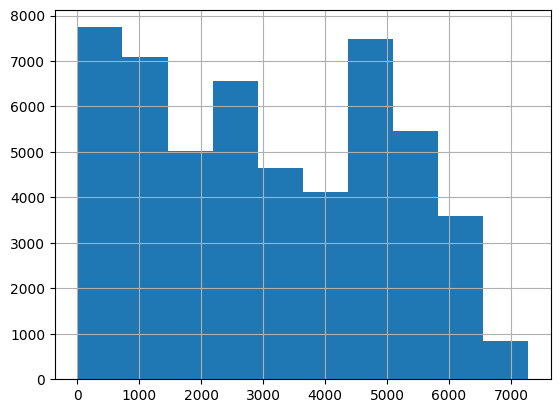

In [ ]:
itog = df_full_ready.describe()
df_full_ready['traffic_volume'].hist()
itog

In [ ]:
print('V = %f' % (itog['traffic_volume']['std']/itog['traffic_volume']['mean']))

V = 0.625891


как мы видим коэффициент вариации достаточно высокий. что говорит о занчительном колебании занчений признака -  т.е. трафик сильно колеблется

### Тест Харки — Бера

Проведем тест Харки — Бера для определения номарльности распределения, чтобы подтвердить предположение об однородности.

In [16]:
!pip install statsmodels

In [17]:
from statsmodels.stats.stattools import jarque_bera
from statsmodels.iolib.table import SimpleTable

row =  [u'JB', u'p-value', u'skew', u'kurtosis']
jb_test = jarque_bera(df_full_ready['traffic_volume'])
a = np.vstack([jb_test])
itog = SimpleTable(a, row)
print(itog)

        JB        p-value         skew             kurtosis     
----------------------------------------------------------------
3681.082334434169     0.0 0.12171448089750453 1.7264656574312909
----------------------------------------------------------------


###  Тест Дикки-Фуллера

проведем обобщенный тест Дикки-Фуллера

In [18]:
from statsmodels.tsa.stattools import adfuller

test = adfuller(df_full_ready['traffic_volume'])
print ('adf: ', test[0])
print ('p-value: ', test[1])
print ('Critical values: ', test[4])
if test[0]> test[4]['5%']:
    print ('есть единичные корни, ряд не стационарен')
else:
    print ('единичных корней нет, ряд стационарен')

adf:  -16.908584166118
p-value:  1.0147770283252129e-29
Critical values:  {'1%': -3.430474583170976, '5%': -2.8615950632605816, '10%': -2.56679930834247}
единичных корней нет, ряд стационарен


##### p-value:  1.014777028325242e-29
##### Результат существенно меньше 5%. Временной ряд стационарен.

## 2. Моделирование

### 2.1. Генерируем новые признаки на основе индекса: час(hour) и день недели(weekday)

In [17]:
df_full_ready['hour']=df_full_ready.index.hour
df_full_ready['weekday']=df_full_ready.index.dayofweek

In [21]:
df_full_ready.tail()

,holiday,temp,traffic_volume,hour,weekday
2018-09-30 19:00:00,NaN,283.45,3543.0,19,6
2018-09-30 20:00:00,NaN,282.76,2781.0,20,6
2018-09-30 21:00:00,NaN,282.73,2159.0,21,6
2018-09-30 22:00:00,NaN,282.09,1450.0,22,6
2018-09-30 23:00:00,NaN,282.12,954.0,23,6


### 2.2. Делим данные на train и test. Последние две недели оставляем на test.

In [18]:
df_train = df_full_ready.loc['2012-10-02 09:00:00':'2018-09-16 23:00:00']
df_train.head()

,holiday,temp,traffic_volume,hour,weekday
2012-10-02 09:00:00,NaN,288.28,5545.0,9,1
2012-10-02 10:00:00,NaN,289.36,4516.0,10,1
2012-10-02 11:00:00,NaN,289.58,4767.0,11,1
2012-10-02 12:00:00,NaN,290.13,5026.0,12,1
2012-10-02 13:00:00,NaN,291.14,4918.0,13,1


In [19]:
df_test = df_full_ready.loc['2018-09-17 00:00:00':]
df_test.head()

,holiday,temp,traffic_volume,hour,weekday
2018-09-17 00:00:00,NaN,296.58,550.0,0,0
2018-09-17 01:00:00,NaN,296.19,280.0,1,0
2018-09-17 02:00:00,NaN,295.82,260.0,2,0
2018-09-17 03:00:00,NaN,295.83,344.0,3,0
2018-09-17 04:00:00,NaN,295.68,880.0,4,0


In [20]:
# удаляем данные с 2012 по 2017 гг.
df_train = df_train.loc['2017-01-01 09:00:00':'2018-09-16 23:00:00']

### 2.3. Базовая модель

#### Посчитаеv средние значения по часам и по дням

In [21]:
df_temp_mean = df_train.groupby(['weekday', 'hour'])['traffic_volume'].mean()

In [22]:
# превращаем полученный объект Series в DataFrame
df_base_mean = df_temp_mean.reset_index()
df_base_mean.head()

,weekday,hour,traffic_volume
0,0,0,664.348315
1,0,1,409.314607
2,0,2,309.258427
3,0,3,356.438202
4,0,4,821.022472


In [23]:
df_base_mean.tail()

,weekday,hour,traffic_volume
163,6,19,3190.922222
164,6,20,2873.266667
165,6,21,2435.377778
166,6,22,1876.000000
167,6,23,1276.755556


In [ ]:
len(df_temp_mean_df)

168

In [ ]:
x1 = df_base_mean.index
y1 = df_base_mean.traffic_volume

fig = px.line(df_temp_mean_df, x1, y1)
fig.show()

как мы видим, с понедельника по пятницу трафик в течение дня примерно одинаковый: основной пик приходится на утреннее и вечернее время, когда люди едут на работу, либо возвращаются с нее. В выходные трафик снижен и пик приходится на обед.
Есть смысл перейти к недельному интервалу и среднему значению на нем, это избавит нас от выбросов и  уменьшит колебания ряда.

In [28]:
df_base_mean

,weekday,hour,traffic_volume
0,0,0,664.348315
1,0,1,409.314607
2,0,2,309.258427
3,0,3,356.438202
4,0,4,821.022472
...,...,...,...
163,6,19,3190.922222
164,6,20,2873.266667
165,6,21,2435.377778
166,6,22,1876.000000


In [24]:
df_test_base = df_test.copy()
df_test_base['ds'] = df_test_base.index
df_test_base.reset_index(inplace=True)
df_test_base.drop(columns =['index'], inplace=True)

df_test_base['ds'] = pd.to_datetime(df_test_base['ds'])

df_test_base.drop(columns =['holiday'], inplace=True)

In [30]:
df_test_base

,temp,traffic_volume,hour,weekday,ds
0,296.58,550.0,0,0,2018-09-17 00:00:00
1,296.19,280.0,1,0,2018-09-17 01:00:00
2,295.82,260.0,2,0,2018-09-17 02:00:00
3,295.83,344.0,3,0,2018-09-17 03:00:00
4,295.68,880.0,4,0,2018-09-17 04:00:00
...,...,...,...,...,...
331,283.45,3543.0,19,6,2018-09-30 19:00:00
332,282.76,2781.0,20,6,2018-09-30 20:00:00
333,282.73,2159.0,21,6,2018-09-30 21:00:00
334,282.09,1450.0,22,6,2018-09-30 22:00:00


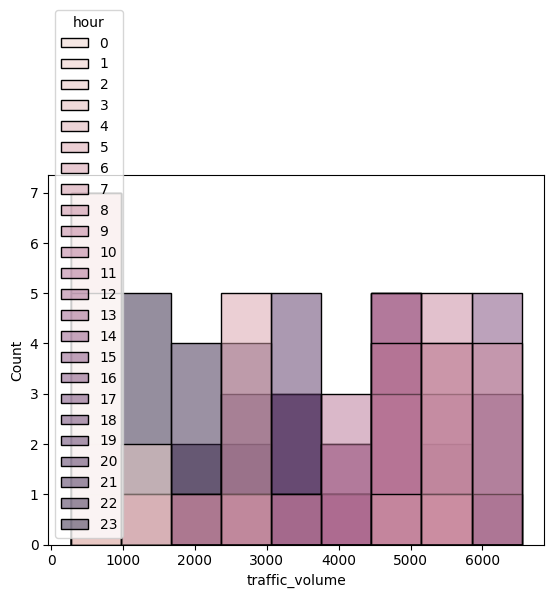

In [ ]:
sns.histplot(x='traffic_volume', hue='hour', data=df_base_mean)
plt.show()

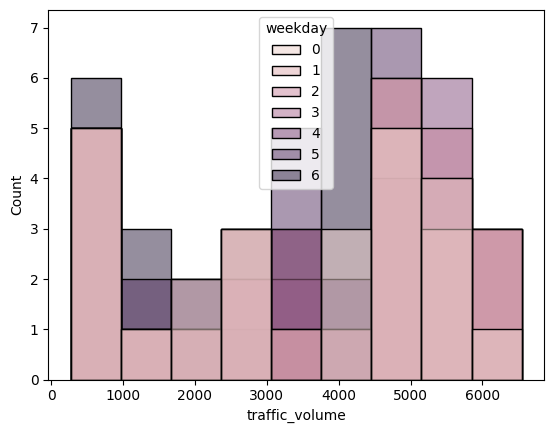

In [ ]:
sns.histplot(x='traffic_volume', hue='weekday', data=df_temp_mean_df)
plt.show()

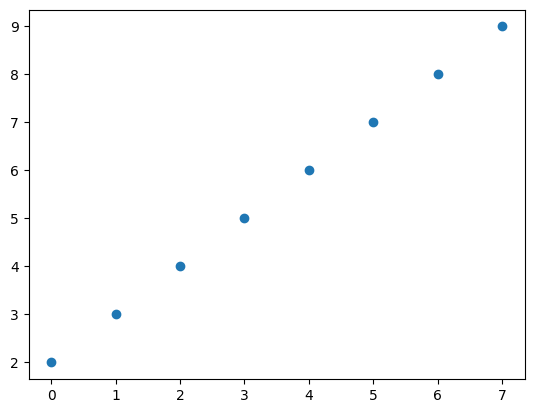

In [ ]:
plt.plot(range(2,10),"D", marker='o');

Выведем графики распредления трафика в течение дня.
Учитывая график выше, в будни можно выделить два пика трафика: 7ч. и 16ч.
В выходные основной трафик приходится на середину дня: с 10ч до 18.30ч

In [ ]:
fig = px.line(df_base_mean,
              x=df_base_mean.hour, y=df_base_mean.traffic_volume,
              # line_shape="spline",
              render_mode="svg", log_y=False)

fig.add_scatter(x=df_base_mean.hour,  y=df_base_mean["traffic_volume"],mode='lines', )

fig.show()

In [26]:
#df['Field_2'] = df['Field_2'].apply(np.int64)
df_base_mean["traffic_volume"] = df_base_mean["traffic_volume"].apply(np.int64)

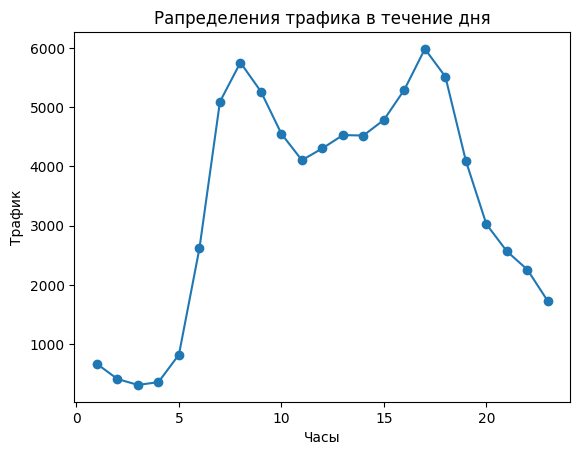

In [ ]:
plt.plot(range(1,24), df_base_mean["traffic_volume"][:23], marker='o');
plt.xlabel('Часы')
plt.ylabel('Трафик')
plt.title('Рапределения трафика в течение дня')
plt.show()

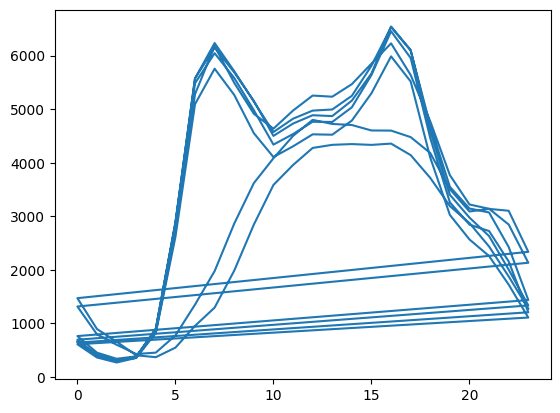

In [ ]:
plt.plot(df_base_mean.hour, df_base_mean.traffic_volume)
plt.show()

### 2.3.1. Оценка базовой модели

In [25]:
# приводим кол-во данных в соответствии с данными по base_line
df_test_base_srez = df_test_base.loc[0:167]
df_test_base_srez

,temp,traffic_volume,hour,weekday,ds
0,296.58,550.0,0,0,2018-09-17 00:00:00
1,296.19,280.0,1,0,2018-09-17 01:00:00
2,295.82,260.0,2,0,2018-09-17 02:00:00
3,295.83,344.0,3,0,2018-09-17 03:00:00
4,295.68,880.0,4,0,2018-09-17 04:00:00
...,...,...,...,...,...
163,295.23,3516.0,19,6,2018-09-23 19:00:00
164,292.94,2846.0,20,6,2018-09-23 20:00:00
165,292.27,2346.0,21,6,2018-09-23 21:00:00
166,291.44,1635.0,22,6,2018-09-23 22:00:00


In [26]:
y_base = df_base_mean['traffic_volume']
y_test_srez = df_test_base_srez['traffic_volume']

In [27]:
# Calculate MAE and RMSE
mae_by_base = mean_absolute_error(y_test_srez, y_base )
rmse_by_base = np.sqrt(mean_squared_error(y_test_srez, y_base ))
print(f'Mean Absolute Error: {mae_by_base:.2f}');
print(f'Root Mean Squared Error: {rmse_by_base:.2f}');

Mean Absolute Error: 218.74
Root Mean Squared Error: 301.44


### 2.3.1. Скользящее среднее - SMA (Simple moving average) / MA (Moving average)

In [31]:
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error, \
    median_absolute_error, mean_squared_error, mean_squared_log_error

In [ ]:
window=10 # создается окно фильтрации
scale=1.96 #2.58 - 99%

df_train["SMA_avg"] = df_train["traffic_volume"].rolling(window=window).mean()
mae = mean_absolute_error(df_train["traffic_volume"][window:].fillna(0), df_train["traffic_volume"][window:].fillna(0))
mae = mean_absolute_error(df_train["traffic_volume"][window:].fillna(0), df_train["SMA_avg"][window:].fillna(0))
std = np.std(df_train["traffic_volume"][window:] -  df_train["SMA_avg"][window:])
df_train["SMA_min"] =  df_train["SMA_avg"] - (mae + scale * std)
df_train["SMA_max"] =  df_train["SMA_avg"]+ (mae + scale * std)

df_train

,holiday,temp,traffic_volume,hour,weekday,SMA_avg,SMA_min,SMA_max
2017-01-01 09:00:00,NaN,267.71,2279.0,9,6,NaN,NaN,NaN
2017-01-01 10:00:00,NaN,269.02,3592.0,10,6,NaN,NaN,NaN
2017-01-01 11:00:00,NaN,270.34,3500.0,11,6,NaN,NaN,NaN
2017-01-01 12:00:00,NaN,271.27,3364.0,12,6,NaN,NaN,NaN
2017-01-01 13:00:00,NaN,271.46,3252.0,13,6,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
2018-09-15 19:00:00,NaN,304.47,3455.0,19,5,4315.0,-1060.666598,9690.666598
2018-09-15 20:00:00,NaN,301.34,3208.0,20,5,4191.0,-1184.666598,9566.666598
2018-09-15 21:00:00,NaN,299.26,3055.0,21,5,4019.3,-1356.366598,9394.966598
2018-09-15 22:00:00,NaN,298.21,2741.0,22,5,3794.4,-1581.266598,9170.066598


In [ ]:
fig = px.line(df_train,
              x=df_train.index, y=df_train.columns[-3:],
              # line_shape="spline",
              render_mode="svg", log_y=False)

fig.add_scatter(x=df_train.index,  y=df_train["traffic_volume"],mode='lines', )

fig.show()

выявим аномалии - больше или меньше среднего значения по простой скользящей средней

In [ ]:
df_train['anomaly_min'] = df_train[df_train['traffic_volume']<df_train["SMA_min"]]['traffic_volume']
df_train['anomaly_max'] = df_train[df_train['traffic_volume']>df_train["SMA_max"]]['traffic_volume']

In [ ]:
df_train

,holiday,temp,traffic_volume,hour,weekday,SMA_avg,SMA_min,SMA_max,exp,anomaly_min,anomaly_max
2017-01-01 09:00:00,NaN,267.71,2279.0,9,6,NaN,NaN,NaN,3320.748366,NaN,NaN
2017-01-01 10:00:00,NaN,269.02,3592.0,10,6,NaN,NaN,NaN,3453.831518,NaN,NaN
2017-01-01 11:00:00,NaN,270.34,3500.0,11,6,NaN,NaN,NaN,3533.035020,NaN,NaN
2017-01-01 12:00:00,NaN,271.27,3364.0,12,6,NaN,NaN,NaN,3586.150022,NaN,NaN
2017-01-01 13:00:00,NaN,271.46,3252.0,13,6,NaN,NaN,NaN,3628.166691,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2018-09-15 19:00:00,NaN,304.47,3455.0,19,5,4315.0,-1060.666598,9690.666598,2668.568700,NaN,NaN
2018-09-15 20:00:00,NaN,301.34,3208.0,20,5,4191.0,-1184.666598,9566.666598,2603.743000,NaN,NaN
2018-09-15 21:00:00,NaN,299.26,3055.0,21,5,4019.3,-1356.366598,9394.966598,2519.270000,NaN,NaN
2018-09-15 22:00:00,NaN,298.21,2741.0,22,5,3794.4,-1581.266598,9170.066598,2410.300000,NaN,NaN


In [ ]:
df_train['anomaly_max'].unique()

array([nan])

In [ ]:
fig = px.line(df_train,
              x=df_train.index, y=df_train.columns[-3:],
              # line_shape="spline",
              render_mode="svg", log_y=False)

fig.add_scatter(x=df_train.index,  y=df_train["traffic_volume"],mode='lines', name='time series')
fig.add_scatter(x=df_train.index,  y=df_train["anomaly_max"],mode='markers', name='anomaly_max')
fig.add_scatter(x=df_train.index,  y=df_train["anomaly_min"],mode='markers', name='anomaly_min')
fig.show()




In [ ]:
df_train['traffic_volume'].rolling(window=10).mean()

2017-01-01 09:00:00       NaN
2017-01-01 10:00:00       NaN
2017-01-01 11:00:00       NaN
2017-01-01 12:00:00       NaN
2017-01-01 13:00:00       NaN
                        ...  
2018-09-15 19:00:00    4315.0
2018-09-15 20:00:00    4191.0
2018-09-15 21:00:00    4019.3
2018-09-15 22:00:00    3794.4
2018-09-15 23:00:00    3521.9
Freq: h, Name: traffic_volume, Length: 14943, dtype: float64

2.3.2. Экспоненциальное сглаживание

In [ ]:
alpha =   0.1
result = [df_train["traffic_volume"][0]] # first value is same as series
for n in range(1,len(df_train["traffic_volume"])):
  result.append(alpha * df_train["traffic_volume"][n] + (1 - alpha) * result[n-1])
result.reverse()
df_train['exp'] = result

In [ ]:
fig = px.line(df_train,
              x=df_train.index, y=df_train.columns[2],
              # line_shape="spline",
              render_mode="svg", log_y=False,)

fig.add_scatter(x=df_train.index,  y=df_train["exp"], mode='lines', name='экспоненциальное сглаживание')

fig.show()

In [25]:
!pip install statsforecast

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.8/275.8 kB 21.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 21.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.3/62.3 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.3/135.3 kB 10.2 MB/s eta 0:00:00


### 2.3.3. Autoregressive AR

#### Добавим фичей в датафрейм

In [ ]:
df_train_ar = df_train.copy()
#df_train_ar.drop(columns =['SMA_avg', 'SMA_min', 'SMA_max', 'anomaly_min', 'anomaly_max'], inplace=True)
df_train_ar

,holiday,temp,traffic_volume,hour,weekday
2017-01-01 09:00:00,NaN,267.71,2279.0,9,6
2017-01-01 10:00:00,NaN,269.02,3592.0,10,6
2017-01-01 11:00:00,NaN,270.34,3500.0,11,6
2017-01-01 12:00:00,NaN,271.27,3364.0,12,6
2017-01-01 13:00:00,NaN,271.46,3252.0,13,6
...,...,...,...,...,...
2018-09-16 19:00:00,NaN,303.02,3400.0,19,6
2018-09-16 20:00:00,NaN,300.78,3092.0,20,6
2018-09-16 21:00:00,NaN,298.90,2623.0,21,6
2018-09-16 22:00:00,NaN,297.85,1725.0,22,6


In [ ]:
# Добавим фичей в датафрейм
for i in range(1, 8):  # Создадим временной лаг на 7 дней
    df_train_ar[f'Lag_{i}'] = df_train_ar['traffic_volume'].shift(i)

# удалим строки с NaN
#bc.dropna(inplace=True)

# Разобьем данные на тестовую и обучающую выборку сохраняя порядок
#train_size = int(0.75 * len(bc))[ ]

#[ ]

#train_data = bc[:train_size]
#test_data = bc[train_size:]

# Define the input features (lag features) and target variable
#y_train = train_data['traffic_volume']


In [ ]:
df_train_ar.tail()

,holiday,temp,traffic_volume,hour,weekday,Lag_1,Lag_2,Lag_3,Lag_4,Lag_5,Lag_6,Lag_7
2018-09-16 19:00:00,NaN,303.02,3400.0,19,6,3701.0,4154.0,4539.0,4101.0,3829.0,3935.0,3978.0
2018-09-16 20:00:00,NaN,300.78,3092.0,20,6,3400.0,3701.0,4154.0,4539.0,4101.0,3829.0,3935.0
2018-09-16 21:00:00,NaN,298.90,2623.0,21,6,3092.0,3400.0,3701.0,4154.0,4539.0,4101.0,3829.0
2018-09-16 22:00:00,NaN,297.85,1725.0,22,6,2623.0,3092.0,3400.0,3701.0,4154.0,4539.0,4101.0
2018-09-16 23:00:00,NaN,297.44,1088.0,23,6,1725.0,2623.0,3092.0,3400.0,3701.0,4154.0,4539.0


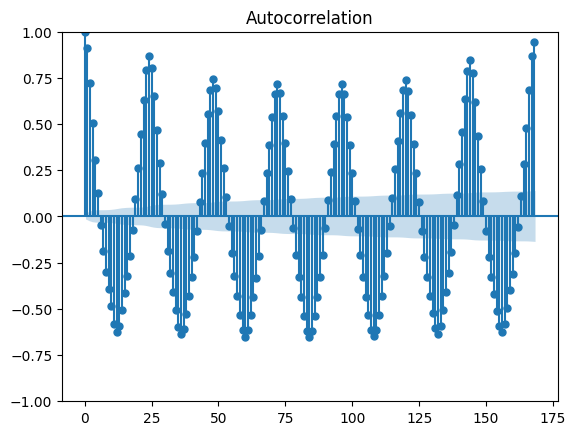

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
plot_acf(df_train_ar['traffic_volume'], lags=168)
plt.show()

Ряд стационарный и не имеет тренда. Видна сезонность.

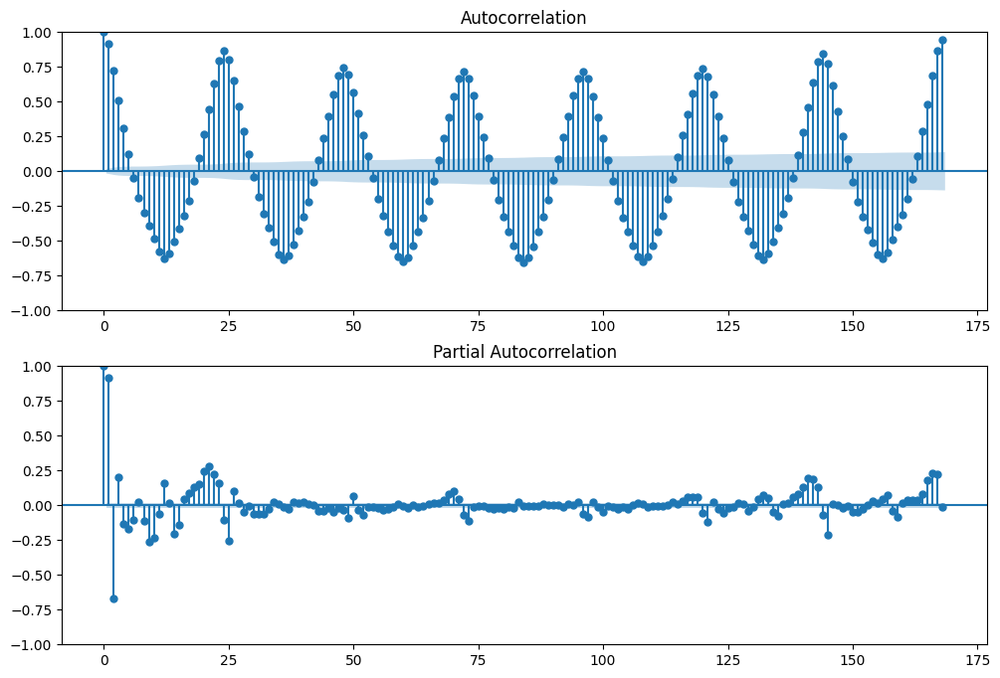

In [ ]:
import statsmodels.api as sm
fig = plt.figure(figsize=(12, 8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_train_ar['traffic_volume'].values.squeeze(), lags=168, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_train_ar['traffic_volume'], lags=168, ax=ax2)

Графики ACF показыват, что самый последний значимый лаг = 1, т.е. q=1, а по PACF аналогично мы определяем, что p=2

In [ ]:
df_train_ar['traffic_volume'].corr(df_train_ar['traffic_volume'].shift(1))

0.9131365366811066

Базовая модель

определим параметры P, D, Q

In [ ]:
df_train_ar

,holiday,temp,traffic_volume,hour,weekday,exp,Lag_1,Lag_2,Lag_3,Lag_4,Lag_5,Lag_6,Lag_7,Lag_8,Lag_9,Lag_10,Lag_11,Lag_12,Lag_13,Lag_14
2016-01-01 09:00:00,NaN,265.76,1574.0,9,4,3320.748366,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-01 10:00:00,NaN,267.61,2059.0,10,4,3453.831518,1574.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-01 11:00:00,NaN,268.52,2632.5,11,4,3533.035020,2059.0,1574.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-01 12:00:00,NaN,269.43,3206.0,12,4,3586.150022,2632.5,2059.0,1574.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-01 13:00:00,NaN,271.77,3498.0,13,4,3628.166691,3206.0,2632.5,2059.0,1574.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-15 19:00:00,NaN,304.47,3455.0,19,5,2034.375000,3826.0,3953.0,4219.0,4296.0,4343.0,4848.0,4990.0,4772.0,4448.0,3999.0,3442.0,2117.0,1469.0,871.0
2018-09-15 20:00:00,NaN,301.34,3208.0,20,5,1871.750000,3455.0,3826.0,3953.0,4219.0,4296.0,4343.0,4848.0,4990.0,4772.0,4448.0,3999.0,3442.0,2117.0,1469.0
2018-09-15 21:00:00,NaN,299.26,3055.0,21,5,1723.500000,3208.0,3455.0,3826.0,3953.0,4219.0,4296.0,4343.0,4848.0,4990.0,4772.0,4448.0,3999.0,3442.0,2117.0
2018-09-15 22:00:00,NaN,298.21,2741.0,22,5,1622.500000,3055.0,3208.0,3455.0,3826.0,3953.0,4219.0,4296.0,4343.0,4848.0,4990.0,4772.0,4448.0,3999.0,3442.0


#### Разложим временной ряд по трафику на компоненты.

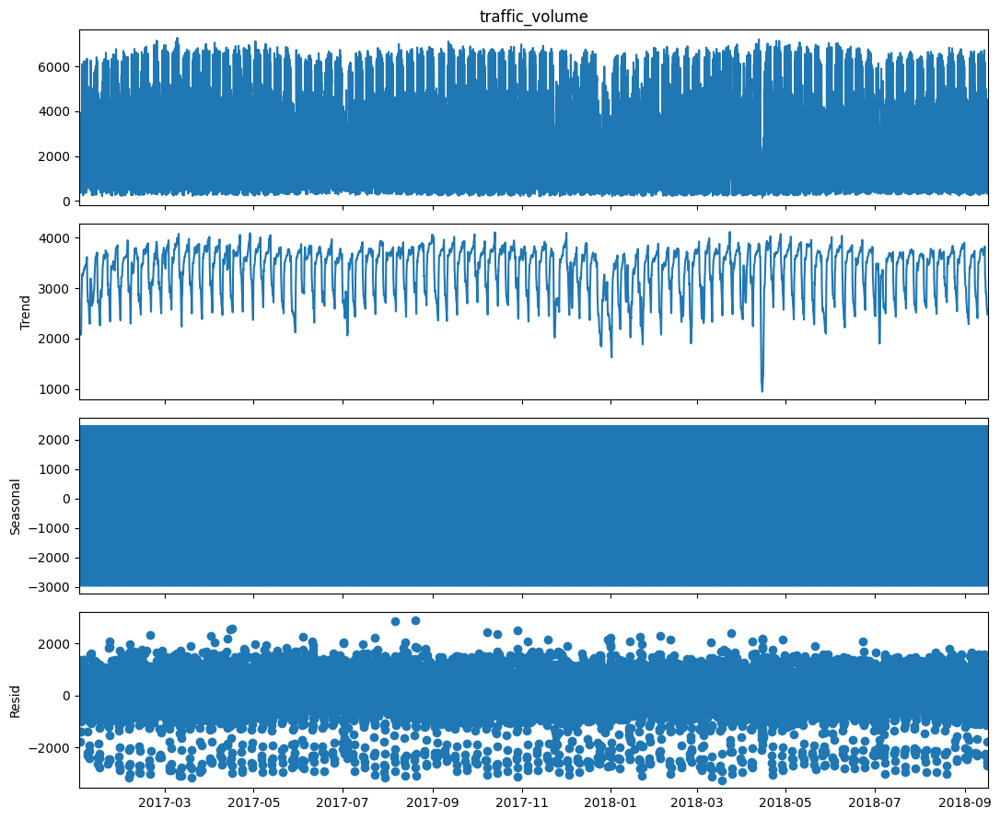

In [ ]:
# импортируем функцию seasonal_decompose из statsmodels
from statsmodels.tsa.seasonal import seasonal_decompose

# задаем размер графика
from pylab import rcParams
rcParams['figure.figsize'] = 11, 9

# применяем функцию к данным о перевозках
decompose = seasonal_decompose(df_train_ar['traffic_volume'])
decompose.plot()

plt.show()

учитываем недельную сезонность - период 24ч на 7 дней в неделю, т.к. данные у нас почасовые

In [ ]:
diff1lev_season1lev = df_train_ar['traffic_volume'].diff(24*7).dropna()


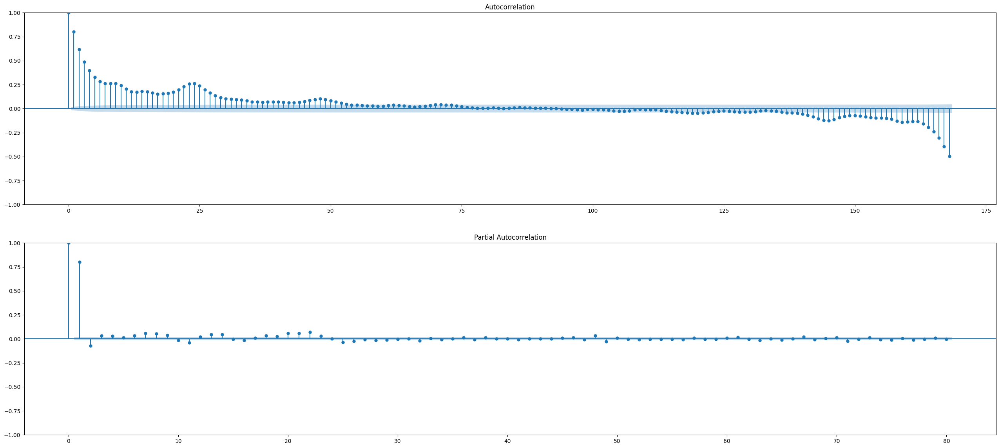

In [ ]:
fig = plt.figure(figsize=(32,14))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(diff1lev_season1lev.values.squeeze(), lags=168, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(diff1lev_season1lev, lags=80, ax=ax2)

Из гарфика PACF видно, что порядок AR будет p=49, а по ACF видно, что порядок MA q = 52, т.к. 52 лаг — это последний лаг отличный от 0.

Сезонная составляющая

смотрим лаги 168 и 336. P=0, Q=0,
s=168 получаем 24*7, чтобы учитывать недельную сезонность

In [ ]:
# еще вариант отдельно использовать SARIMAX
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [ ]:
df_train_ar
#df_x.drop(columns =['rain_1h', 'snow_1h', 'weather_main', 'weather_description', 'clouds_all'], inplace=True)

,holiday,temp,traffic_volume,hour,weekday,Lag_1,Lag_2,Lag_3,Lag_4,Lag_5,Lag_6,Lag_7
2017-01-01 09:00:00,NaN,267.71,2279.0,9,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-01 10:00:00,NaN,269.02,3592.0,10,6,2279.0,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-01 11:00:00,NaN,270.34,3500.0,11,6,3592.0,2279.0,NaN,NaN,NaN,NaN,NaN
2017-01-01 12:00:00,NaN,271.27,3364.0,12,6,3500.0,3592.0,2279.0,NaN,NaN,NaN,NaN
2017-01-01 13:00:00,NaN,271.46,3252.0,13,6,3364.0,3500.0,3592.0,2279.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-16 19:00:00,NaN,303.02,3400.0,19,6,3701.0,4154.0,4539.0,4101.0,3829.0,3935.0,3978.0
2018-09-16 20:00:00,NaN,300.78,3092.0,20,6,3400.0,3701.0,4154.0,4539.0,4101.0,3829.0,3935.0
2018-09-16 21:00:00,NaN,298.90,2623.0,21,6,3092.0,3400.0,3701.0,4154.0,4539.0,4101.0,3829.0
2018-09-16 22:00:00,NaN,297.85,1725.0,22,6,2623.0,3092.0,3400.0,3701.0,4154.0,4539.0,4101.0


In [ ]:
df_train_ar.drop(columns =['exp', 'Lag_1', 'Lag_2', 'Lag_3', 'Lag_4', 'Lag_5', 'Lag_6', 'Lag_7', 'Lag_8', 'Lag_9', 'Lag_10', 'Lag_11', 'Lag_12', 'Lag_13', 'Lag_14'], inplace=True)

In [ ]:
df_train_ar


,holiday,temp,traffic_volume,hour,weekday
2017-01-01 09:00:00,NaN,267.71,2279.0,9,6
2017-01-01 10:00:00,NaN,269.02,3592.0,10,6
2017-01-01 11:00:00,NaN,270.34,3500.0,11,6
2017-01-01 12:00:00,NaN,271.27,3364.0,12,6
2017-01-01 13:00:00,NaN,271.46,3252.0,13,6
...,...,...,...,...,...
2018-09-15 19:00:00,NaN,304.47,3455.0,19,5
2018-09-15 20:00:00,NaN,301.34,3208.0,20,5
2018-09-15 21:00:00,NaN,299.26,3055.0,21,5
2018-09-15 22:00:00,NaN,298.21,2741.0,22,5


In [ ]:
y_train_tr = df_train_ar['traffic_volume']

In [ ]:
sarima = SARIMAX(y_train_tr, order=(49, 1, 52), seasonal_order=(0, 1, 0, 168)).fit()

print(sarima.params)

In [ ]:
print(sarima.summary())

In [ ]:
# Calculate MAE and RMSE
mae_by_base = mean_absolute_error(y_test_srez, y_base )
rmse_by_base = np.sqrt(mean_squared_error(y_test_srez, y_base ))
print(f'Mean Absolute Error: {mae_by_base:.2f}');
print(f'Root Mean Squared Error: {rmse_by_base:.2f}');

модель SARIMAX не сработала - она висит и никак не реагирует и не показывает никаого прогресса, поэтому решил не дожидаться ее ответа.

#### 2.3.3.1 Обучение AR

In [26]:
y_train = df_train_ar['traffic_volume']

NameError: name 'df_train_ar' is not defined

In [ ]:
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.graphics.tsaplots import plot_acf
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Создадим и обучим авторегрессионную модель
lag_order = [1, 24, 48, ] # Зададим анализ сдвигов на основе АКФ


ar_model = AutoReg(y_train, lags=lag_order)
ar_results = ar_model.fit()

In [ ]:
ar_results.params

,0
const,-444.870325
traffic_volume.L1,0.799722
traffic_volume.L20,0.144465
traffic_volume.L40,0.027983
traffic_volume.L120,0.162136


In [ ]:
y_test = df_test['traffic_volume']

In [ ]:
# Make predictions on the test set
y_pred = ar_results.predict(start=len(y_train), end=len(y_train) + len(y_test) - 1, dynamic=False)
#print(y_pred)

# Calculate MAE and RMSE
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Mean Absolute Error: {mae:.2f}');
print(f'Root Mean Squared Error: {rmse:.2f}');

Mean Absolute Error: 1848.36
Root Mean Squared Error: 2279.17


In [ ]:
fig = px.line(df_full_ready,
              x=df_test.index, y=y_test,
              # line_shape="spline",
              render_mode="svg", log_y=False,)
fig.add_scatter(x=df_test.index,  y=y_pred,mode='lines', name='AR')
fig.show()

### 2.4. Auto ARIMA и признаки фурье

In [42]:
# Import packages
import plotly.graph_objects as go
import pandas as pd
import os
from scipy.stats import boxcox
from scipy.special import inv_boxcox
import numpy as np

In [42]:
!pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 28.0 MB/s eta 0:00:00


In [28]:
df_full_ready

,holiday,temp,traffic_volume,hour,weekday
2012-10-02 09:00:00,NaN,288.28,5545.0,9,1
2012-10-02 10:00:00,NaN,289.36,4516.0,10,1
2012-10-02 11:00:00,NaN,289.58,4767.0,11,1
2012-10-02 12:00:00,NaN,290.13,5026.0,12,1
2012-10-02 13:00:00,NaN,291.14,4918.0,13,1
...,...,...,...,...,...
2018-09-30 19:00:00,NaN,283.45,3543.0,19,6
2018-09-30 20:00:00,NaN,282.76,2781.0,20,6
2018-09-30 21:00:00,NaN,282.73,2159.0,21,6
2018-09-30 22:00:00,NaN,282.09,1450.0,22,6


In [51]:
#df_tmp = df_full_ready.loc['2017-10-02 09:00:00':'2018-09-16 23:00:00']
df_tmp=df_full_ready.loc['2017-10-02 09:00:00':'2018-09-30 23:00:00']

In [52]:
df_tmp

,holiday,temp,traffic_volume,hour,weekday
2017-10-02 09:00:00,NaN,286.75,5018.0,9,0
2017-10-02 10:00:00,NaN,287.86,4342.0,10,0
2017-10-02 11:00:00,NaN,289.93,4519.0,11,0
2017-10-02 12:00:00,NaN,290.57,4683.0,12,0
2017-10-02 13:00:00,NaN,291.48,4670.0,13,0
...,...,...,...,...,...
2018-09-30 19:00:00,NaN,283.45,3543.0,19,6
2018-09-30 20:00:00,NaN,282.76,2781.0,20,6
2018-09-30 21:00:00,NaN,282.73,2159.0,21,6
2018-09-30 22:00:00,NaN,282.09,1450.0,22,6


In [53]:
df_tmp['data_time'] = df_tmp.index

In [54]:
df_tmp.reset_index(inplace=True)

In [48]:
df_tmp.drop(columns =['index'], inplace=True)

In [55]:
df_tmp

,index,holiday,temp,traffic_volume,hour,weekday,data_time
0,2017-10-02 09:00:00,NaN,286.75,5018.0,9,0,2017-10-02 09:00:00
1,2017-10-02 10:00:00,NaN,287.86,4342.0,10,0,2017-10-02 10:00:00
2,2017-10-02 11:00:00,NaN,289.93,4519.0,11,0,2017-10-02 11:00:00
3,2017-10-02 12:00:00,NaN,290.57,4683.0,12,0,2017-10-02 12:00:00
4,2017-10-02 13:00:00,NaN,291.48,4670.0,13,0,2017-10-02 13:00:00
...,...,...,...,...,...,...,...
8722,2018-09-30 19:00:00,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,2018-09-30 20:00:00,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,2018-09-30 21:00:00,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,2018-09-30 22:00:00,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [56]:
# Стабилизируем дисперсию с помощью преобразования Бокса-Кокса и приводим ряд к стационарному (среднее значение не изменяется во времени)
df_tmp['traffic_volume_Boxcox'], lam = boxcox(df_tmp['traffic_volume'])
#df_tmp.dropna(inplace=True)

In [57]:
# Получаем признаки Фурье на основе N числа гармоник
for order in range(1, 14):
    df_tmp[f'fourier_sin_order_{order}'] = np.sin(2 * np.pi * order * df_tmp['hour'] * df_tmp['weekday'] / 24 * 7)
    df_tmp[f'fourier_cos_order_{order}'] = np.cos(2 * np.pi * order * df_tmp['hour'] * df_tmp['weekday'] / 24 * 7)

In [58]:
df_train_auto_arima = df_tmp.loc[2019:8366]
df_test_auto_arima = df_tmp.loc[8367:8727]
#df_train_auto_arima = df_tmp.copy()

In [59]:
df_train_auto_arima

,index,holiday,temp,traffic_volume,hour,weekday,data_time,traffic_volume_Boxcox,fourier_sin_order_1,fourier_cos_order_1,...,fourier_sin_order_9,fourier_cos_order_9,fourier_sin_order_10,fourier_cos_order_10,fourier_sin_order_11,fourier_cos_order_11,fourier_sin_order_12,fourier_cos_order_12,fourier_sin_order_13,fourier_cos_order_13
2019,2017-12-25 12:00:00,NaN,253.65,2957.0,12,0,2017-12-25 12:00:00,478.468215,0.000000,1.000000,...,0.000000e+00,1.000000e+00,0.000000,1.000000e+00,0.000000,1.000000,0.000000e+00,1.0,0.000000,1.000000
2020,2017-12-25 13:00:00,NaN,254.15,2983.0,13,0,2017-12-25 13:00:00,481.560155,0.000000,1.000000,...,0.000000e+00,1.000000e+00,0.000000,1.000000e+00,0.000000,1.000000,0.000000e+00,1.0,0.000000,1.000000
2021,2017-12-25 14:00:00,NaN,254.29,2850.0,14,0,2017-12-25 14:00:00,465.666502,0.000000,1.000000,...,0.000000e+00,1.000000e+00,0.000000,1.000000e+00,0.000000,1.000000,0.000000e+00,1.0,0.000000,1.000000
2022,2017-12-25 15:00:00,NaN,254.42,2732.0,15,0,2017-12-25 15:00:00,451.399296,0.000000,1.000000,...,0.000000e+00,1.000000e+00,0.000000,1.000000e+00,0.000000,1.000000,0.000000e+00,1.0,0.000000,1.000000
2023,2017-12-25 16:00:00,NaN,254.28,3045.0,16,0,2017-12-25 16:00:00,488.904462,0.000000,1.000000,...,0.000000e+00,1.000000e+00,0.000000,1.000000e+00,0.000000,1.000000,0.000000e+00,1.0,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8362,2018-09-15 19:00:00,NaN,304.47,3455.0,19,5,2018-09-15 19:00:00,536.516790,-0.965926,-0.258819,...,7.071068e-01,-7.071068e-01,0.500000,8.660254e-01,-0.965926,0.258819,4.615794e-13,-1.0,0.965926,0.258819
8363,2018-09-15 20:00:00,NaN,301.34,3208.0,20,5,2018-09-15 20:00:00,508.025996,0.866025,0.500000,...,8.916295e-14,-1.000000e+00,-0.866025,-5.000000e-01,-0.866025,0.500000,1.842810e-13,1.0,0.866025,0.500000
8364,2018-09-15 21:00:00,NaN,299.26,3055.0,21,5,2018-09-15 21:00:00,490.085281,-0.707107,-0.707107,...,-7.071068e-01,-7.071068e-01,1.000000,-1.612458e-13,-0.707107,0.707107,7.935340e-14,-1.0,0.707107,0.707107
8365,2018-09-15 22:00:00,NaN,298.21,2741.0,22,5,2018-09-15 22:00:00,452.493174,0.500000,0.866025,...,-1.000000e+00,1.975065e-13,-0.866025,5.000000e-01,-0.500000,0.866025,1.117596e-13,1.0,0.500000,0.866025


In [60]:
# name of fourier features
fourier_features = [i for i in list(df_train_auto_arima) if i.startswith('fourier')]

In [61]:
# Строим модель auto-ARIMA по признакам Фурье
import pmdarima as pm
model_auto_arima = pm.auto_arima(df_train_auto_arima['traffic_volume_Boxcox'],
                      X=df_train_auto_arima[fourier_features],
                      seasonal=False,
                      stepwise=True,
                      suppress_warnings=True,
                      max_order=None,
                      information_criterion='aicc',
                      error_action="ignore")

In [68]:
# Получаем прогнозы и применяем обратное преобразование Бокса-Кокса
boxcox_forecasts = model_auto_arima.predict(n_periods=len(df_test_auto_arima), X=df_test_auto_arima[fourier_features])
forecasts = inv_boxcox(boxcox_forecasts, lam)

In [69]:
df_test_auto_arima

,index,holiday,temp,traffic_volume,hour,weekday,data_time,traffic_volume_Boxcox,fourier_sin_order_1,fourier_cos_order_1,...,fourier_sin_order_9,fourier_cos_order_9,fourier_sin_order_10,fourier_cos_order_10,fourier_sin_order_11,fourier_cos_order_11,fourier_sin_order_12,fourier_cos_order_12,fourier_sin_order_13,fourier_cos_order_13
8367,2018-09-16 00:00:00,NaN,297.57,1353.0,0,6,2018-09-16 00:00:00,269.003584,0.000000e+00,1.000000e+00,...,0.000000e+00,1.000000e+00,0.000000e+00,1.0,0.000000e+00,1.000000e+00,0.000000e+00,1.0,0.000000e+00,1.000000e+00
8368,2018-09-16 01:00:00,NaN,297.11,786.0,1,6,2018-09-16 01:00:00,180.141689,-1.000000e+00,-4.286264e-16,...,-1.000000e+00,1.471433e-15,2.204983e-14,-1.0,1.000000e+00,1.714939e-14,1.961911e-15,1.0,-1.000000e+00,2.107321e-14
8369,2018-09-16 02:00:00,NaN,296.77,607.0,2,6,2018-09-16 02:00:00,148.792145,8.572528e-16,-1.000000e+00,...,-2.942866e-15,-1.000000e+00,-4.409966e-14,1.0,3.429878e-14,-1.000000e+00,3.923822e-15,1.0,-4.214642e-14,-1.000000e+00
8370,2018-09-16 03:00:00,NaN,296.42,401.0,3,6,2018-09-16 03:00:00,109.411313,1.000000e+00,-4.904777e-16,...,1.000000e+00,5.242912e-14,1.087821e-13,-1.0,-1.000000e+00,-5.144816e-14,5.885732e-15,1.0,1.000000e+00,5.046721e-14
8371,2018-09-16 04:00:00,NaN,295.83,313.0,4,6,2018-09-16 04:00:00,90.998581,-1.714506e-15,1.000000e+00,...,5.885732e-15,1.000000e+00,-8.819933e-14,1.0,-6.859755e-14,1.000000e+00,7.847643e-15,1.0,8.429284e-14,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8722,2018-09-30 19:00:00,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00,546.534942,1.000000e+00,3.478925e-14,...,1.000000e+00,1.425730e-13,6.832025e-15,-1.0,-1.000000e+00,-3.258384e-13,-1.900974e-13,1.0,1.000000e+00,-4.003910e-13
8723,2018-09-30 20:00:00,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00,457.343346,-4.409966e-14,1.000000e+00,...,2.942866e-14,1.000000e+00,1.842810e-13,1.0,-3.429878e-13,1.000000e+00,-8.702565e-13,1.0,-3.328316e-14,1.000000e+00
8724,2018-09-30 21:00:00,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00,379.583516,-1.000000e+00,3.433344e-15,...,-1.000000e+00,2.014304e-13,7.935340e-14,-1.0,1.000000e+00,3.601371e-13,2.685738e-13,1.0,-1.000000e+00,-1.220995e-14
8725,2018-09-30 22:00:00,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00,283.093571,3.429878e-14,-1.000000e+00,...,-1.460584e-13,-1.000000e+00,1.117596e-13,1.0,3.772865e-13,-1.000000e+00,4.316204e-14,1.0,-9.183580e-13,-1.000000e+00


In [70]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_auto_arima['data_time'], y=df_test_auto_arima['traffic_volume'], name='Test'))
fig.add_trace(go.Scatter(x=df_test_auto_arima['data_time'], y=forecasts, name='Forecast'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='traffic volume')

In [92]:
# Преобразуем данные типа Series в DataFrame
forecasts_ts = {'traffic_volume': forecasts}
forecasts_test = pd.DataFrame(forecasts_ts)
type(forecasts_test)

pandas.core.frame.DataFrame

In [98]:
#заменим Nan на средние значения
forecasts_test.fillna(forecasts_test.mean(), inplace=True)

In [99]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_auto_arima['data_time'], y=df_test_auto_arima['traffic_volume'], name='Test'))
fig.add_trace(go.Scatter(x=df_test_auto_arima['data_time'], y=forecasts_test['traffic_volume'], name='Forecast'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='traffic volume')

In [97]:
y_test_fourie = df_test_auto_arima['traffic_volume']
# Calculate MAE and RMSE
mae_by_fourie = mean_absolute_error(y_test_fourie, forecasts_test['traffic_volume'] )
rmse_by_fourie = np.sqrt(mean_squared_error(y_test_fourie, forecasts_test['traffic_volume']  ))
print(f'Mean Absolute Error: {mae_by_fourie:.2f}');
print(f'Root Mean Squared Error: {rmse_by_fourie:.2f}');

Mean Absolute Error: 1937.78
Root Mean Squared Error: 2391.95


## 2.5. Nixtla

In [100]:
!pip install statsforecast

In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from statsforecast import StatsForecast
from statsforecast.models import AutoARIMA

In [102]:
df_nixtla = df_full_ready.loc['2017-10-02 09:00:00':'2018-09-30 23:00:00']

In [103]:
# Split train and test
df_train_tmp = df_nixtla.loc[:'2018-09-16 23:00:00']
df_test_tmp = df_nixtla.loc['2018-09-17 00:00:00':]

In [104]:
df_train_tmp

,holiday,temp,traffic_volume,hour,weekday
2017-10-02 09:00:00,NaN,286.75,5018.0,9,0
2017-10-02 10:00:00,NaN,287.86,4342.0,10,0
2017-10-02 11:00:00,NaN,289.93,4519.0,11,0
2017-10-02 12:00:00,NaN,290.57,4683.0,12,0
2017-10-02 13:00:00,NaN,291.48,4670.0,13,0
...,...,...,...,...,...
2018-09-16 19:00:00,NaN,303.02,3400.0,19,6
2018-09-16 20:00:00,NaN,300.78,3092.0,20,6
2018-09-16 21:00:00,NaN,298.90,2623.0,21,6
2018-09-16 22:00:00,NaN,297.85,1725.0,22,6


In [105]:
df_train_tmp['ds'] = df_train_tmp.index
df_train_tmp.reset_index(inplace=True)
df_train_tmp.drop(columns =['index'], inplace=True)

In [106]:
df_test_tmp['ds'] = df_test_tmp.index
df_test_tmp.reset_index(inplace=True)
df_test_tmp.drop(columns =['index'], inplace=True)

In [107]:
df_train_tmp['ds'] = pd.to_datetime(df_train_tmp['ds'])
df_test_tmp['ds'] = pd.to_datetime(df_test_tmp['ds'])

In [108]:
df_tmp_nixtla = pd.concat([df_train_tmp, df_test_tmp], ignore_index=True, sort=False)


In [149]:
df_train_nixtla = df_tmp_nixtla.loc[0:8390]
df_test_nixtla = df_tmp_nixtla.loc[8391:]

In [150]:
df_test_nixtla

,holiday,temp,traffic_volume,hour,weekday,ds
8391,NaN,296.58,550.0,0,0,2018-09-17 00:00:00
8392,NaN,296.19,280.0,1,0,2018-09-17 01:00:00
8393,NaN,295.82,260.0,2,0,2018-09-17 02:00:00
8394,NaN,295.83,344.0,3,0,2018-09-17 03:00:00
8395,NaN,295.68,880.0,4,0,2018-09-17 04:00:00
...,...,...,...,...,...,...
8722,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [ ]:
#df_train_nixtla['traffic_volume'] = df_train_nixtla['traffic_volume'].astype(float)
#df_train_nixtla['hour'] = df_train_nixtla['hour'].astype(float)
# fcsts_df = fcst.forecast(df=panel_df, h=12, fitted=True, level=(90, 10))

In [151]:
sf = StatsForecast(
    models = [AutoARIMA(approximation=True)],
    freq = 'h'
)

In [152]:
df_train_nixtla.drop(columns =['hour', 'holiday', 'temp', 'weekday'], inplace=True)

In [153]:
df_train_nixtla

,traffic_volume,ds
0,5018.0,2017-10-02 09:00:00
1,4342.0,2017-10-02 10:00:00
2,4519.0,2017-10-02 11:00:00
3,4683.0,2017-10-02 12:00:00
4,4670.0,2017-10-02 13:00:00
...,...,...
8386,3400.0,2018-09-16 19:00:00
8387,3092.0,2018-09-16 20:00:00
8388,2623.0,2018-09-16 21:00:00
8389,1725.0,2018-09-16 22:00:00


In [154]:
df_train_nixtla["unique_id"] = 1

In [155]:
df_train_nixtla

,traffic_volume,ds,unique_id
0,5018.0,2017-10-02 09:00:00,1
1,4342.0,2017-10-02 10:00:00,1
2,4519.0,2017-10-02 11:00:00,1
3,4683.0,2017-10-02 12:00:00,1
4,4670.0,2017-10-02 13:00:00,1
...,...,...,...
8386,3400.0,2018-09-16 19:00:00,1
8387,3092.0,2018-09-16 20:00:00,1
8388,2623.0,2018-09-16 21:00:00,1
8389,1725.0,2018-09-16 22:00:00,1


In [156]:
df_train_nixtla.columns = ['y', 'ds', 'unique_id']

In [119]:
fig = px.line(df_train_nixtla,
              #x="ds", y=df_train_nixtla.columns[-3],
              x=df_train_nixtla['ds'] , y=df_train_nixtla.columns[-3],
              # line_shape="spline",
              render_mode="svg", log_y=False)


fig.show()

In [157]:
df_train_nixtla.tail()

,y,ds,unique_id
8386,3400.0,2018-09-16 19:00:00,1
8387,3092.0,2018-09-16 20:00:00,1
8388,2623.0,2018-09-16 21:00:00,1
8389,1725.0,2018-09-16 22:00:00,1
8390,1088.0,2018-09-16 23:00:00,1


In [158]:
sf.fit(df_train_nixtla)
result = sf.predict(h=336, level=[95])

In [159]:
result

,unique_id,ds,AutoARIMA,AutoARIMA-lo-95,AutoARIMA-hi-95
0,1,2018-09-17 00:00:00,1039.507502,-57.987667,2137.002672
1,1,2018-09-17 01:00:00,1385.699412,-763.827455,3535.226278
2,1,2018-09-17 02:00:00,1807.032389,-1085.906332,4699.971110
3,1,2018-09-17 03:00:00,2197.442786,-1097.531047,5492.416620
4,1,2018-09-17 04:00:00,2594.233169,-921.826128,6110.292466
...,...,...,...,...,...
331,1,2018-09-30 19:00:00,3318.518999,-561.993055,7199.031053
332,1,2018-09-30 20:00:00,3318.518999,-561.993055,7199.031053
333,1,2018-09-30 21:00:00,3318.518999,-561.993055,7199.031053
334,1,2018-09-30 22:00:00,3318.518999,-561.993055,7199.031053


In [132]:
df_test_nixtla

,holiday,temp,traffic_volume,hour,weekday,ds
8392,NaN,296.19,280.0,1,0,2018-09-17 01:00:00
8393,NaN,295.82,260.0,2,0,2018-09-17 02:00:00
8394,NaN,295.83,344.0,3,0,2018-09-17 03:00:00
8395,NaN,295.68,880.0,4,0,2018-09-17 04:00:00
8396,NaN,295.35,2965.0,5,0,2018-09-17 05:00:00
...,...,...,...,...,...,...
8722,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [ ]:
df_train_nixtla.columns = ['y', 'ds', 'unique_id']

In [142]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_nixtla['ds'], y=df_test_nixtla['traffic_volume'], name='Test'))
fig.add_trace(go.Scatter(x=result['ds'], y=result['AutoARIMA'], name='AutoARIMA'))
fig.add_trace(go.Scatter(x=result['ds'], y=result['AutoARIMA-lo-95'], name='AutoARIMA-lo-95'))
fig.add_trace(go.Scatter(x=result['ds'], y=result['AutoARIMA-hi-95'], name='AutoARIMA-hi-95'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='traffic volume')

In [160]:
forecasts_df = sf.forecast(df=df_train_nixtla, h=335, level=[95])
forecasts_df.tail(20)

,unique_id,ds,AutoARIMA,AutoARIMA-lo-90,AutoARIMA-lo-10,AutoARIMA-hi-10,AutoARIMA-hi-90
315,1,2018-09-30 03:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
316,1,2018-09-30 04:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
317,1,2018-09-30 05:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
318,1,2018-09-30 06:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
319,1,2018-09-30 07:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
320,1,2018-09-30 08:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
321,1,2018-09-30 09:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
322,1,2018-09-30 10:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
323,1,2018-09-30 11:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375
324,1,2018-09-30 12:00:00,3318.518999,61.890624,3069.723422,3567.314577,6575.147375


In [146]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_nixtla['ds'], y=df_test_nixtla['traffic_volume'], name='Test'))
fig.add_trace(go.Scatter(x=forecasts_df['ds'], y=forecasts_df['AutoARIMA'], name='AutoARIMA'))
fig.add_trace(go.Scatter(x=forecasts_df['ds'], y=forecasts_df['AutoARIMA-lo-95'], name='AutoARIMA-lo-95'))
fig.add_trace(go.Scatter(x=forecasts_df['ds'], y=forecasts_df['AutoARIMA-hi-95'], name='AutoARIMA-hi-95'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='traffic volume')

In [126]:
df_test_auto_arima.loc['':]

,index,holiday,temp,traffic_volume,hour,weekday,data_time,traffic_volume_Boxcox,fourier_sin_order_1,fourier_cos_order_1,...,fourier_sin_order_9,fourier_cos_order_9,fourier_sin_order_10,fourier_cos_order_10,fourier_sin_order_11,fourier_cos_order_11,fourier_sin_order_12,fourier_cos_order_12,fourier_sin_order_13,fourier_cos_order_13
8367,2018-09-16 00:00:00,NaN,297.57,1353.0,0,6,2018-09-16 00:00:00,269.003584,0.000000e+00,1.000000e+00,...,0.000000e+00,1.000000e+00,0.000000e+00,1.0,0.000000e+00,1.000000e+00,0.000000e+00,1.0,0.000000e+00,1.000000e+00
8368,2018-09-16 01:00:00,NaN,297.11,786.0,1,6,2018-09-16 01:00:00,180.141689,-1.000000e+00,-4.286264e-16,...,-1.000000e+00,1.471433e-15,2.204983e-14,-1.0,1.000000e+00,1.714939e-14,1.961911e-15,1.0,-1.000000e+00,2.107321e-14
8369,2018-09-16 02:00:00,NaN,296.77,607.0,2,6,2018-09-16 02:00:00,148.792145,8.572528e-16,-1.000000e+00,...,-2.942866e-15,-1.000000e+00,-4.409966e-14,1.0,3.429878e-14,-1.000000e+00,3.923822e-15,1.0,-4.214642e-14,-1.000000e+00
8370,2018-09-16 03:00:00,NaN,296.42,401.0,3,6,2018-09-16 03:00:00,109.411313,1.000000e+00,-4.904777e-16,...,1.000000e+00,5.242912e-14,1.087821e-13,-1.0,-1.000000e+00,-5.144816e-14,5.885732e-15,1.0,1.000000e+00,5.046721e-14
8371,2018-09-16 04:00:00,NaN,295.83,313.0,4,6,2018-09-16 04:00:00,90.998581,-1.714506e-15,1.000000e+00,...,5.885732e-15,1.000000e+00,-8.819933e-14,1.0,-6.859755e-14,1.000000e+00,7.847643e-15,1.0,8.429284e-14,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8722,2018-09-30 19:00:00,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00,546.534942,1.000000e+00,3.478925e-14,...,1.000000e+00,1.425730e-13,6.832025e-15,-1.0,-1.000000e+00,-3.258384e-13,-1.900974e-13,1.0,1.000000e+00,-4.003910e-13
8723,2018-09-30 20:00:00,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00,457.343346,-4.409966e-14,1.000000e+00,...,2.942866e-14,1.000000e+00,1.842810e-13,1.0,-3.429878e-13,1.000000e+00,-8.702565e-13,1.0,-3.328316e-14,1.000000e+00
8724,2018-09-30 21:00:00,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00,379.583516,-1.000000e+00,3.433344e-15,...,-1.000000e+00,2.014304e-13,7.935340e-14,-1.0,1.000000e+00,3.601371e-13,2.685738e-13,1.0,-1.000000e+00,-1.220995e-14
8725,2018-09-30 22:00:00,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00,283.093571,3.429878e-14,-1.000000e+00,...,-1.460584e-13,-1.000000e+00,1.117596e-13,1.0,3.772865e-13,-1.000000e+00,4.316204e-14,1.0,-9.183580e-13,-1.000000e+00


In [161]:
y_test_autoarima = df_test_tmp['traffic_volume']
# Calculate MAE and RMSE
mae_by_autoarima = mean_absolute_error(y_test_autoarima, result['AutoARIMA'])
rmse_by_autoarima = np.sqrt(mean_squared_error(y_test_autoarima, result['AutoARIMA'] ))
print(f'Mean Absolute Error: {mae_by_autoarima:.2f}');
print(f'Root Mean Squared Error: {rmse_by_autoarima:.2f}');

Mean Absolute Error: 1694.96
Root Mean Squared Error: 1930.67


### 2.7. AutoTs

In [164]:
df_autots = df_full_ready.loc['2017-10-02 09:00:00':'2018-09-30 23:00:00']
# Split train and test
#df_train_autots = df_autots.loc[:'2018-09-16 23:00:00']
#df_test_autots = df_autots.loc['2018-09-17 00:00:00':]

In [168]:
df_autots['ds'] = df_autots.index
df_autots.reset_index(inplace=True)
df_autots.drop(columns =['index'], inplace=True)

df_autots['ds'] = pd.to_datetime(df_autots['ds'])
df_autots

,holiday,temp,traffic_volume,hour,weekday,ds
0,NaN,286.75,5018.0,9,0,2017-10-02 09:00:00
1,NaN,287.86,4342.0,10,0,2017-10-02 10:00:00
2,NaN,289.93,4519.0,11,0,2017-10-02 11:00:00
3,NaN,290.57,4683.0,12,0,2017-10-02 12:00:00
4,NaN,291.48,4670.0,13,0,2017-10-02 13:00:00
...,...,...,...,...,...,...
8722,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [185]:
df_train_autots = df_autots.loc[:8366]
df_test_autots = df_autots.loc[8367:]

In [186]:
df_test_autots

,holiday,temp,traffic_volume,hour,weekday,ds
8367,NaN,297.57,1353.0,0,6,2018-09-16 00:00:00
8368,NaN,297.11,786.0,1,6,2018-09-16 01:00:00
8369,NaN,296.77,607.0,2,6,2018-09-16 02:00:00
8370,NaN,296.42,401.0,3,6,2018-09-16 03:00:00
8371,NaN,295.83,313.0,4,6,2018-09-16 04:00:00
...,...,...,...,...,...,...
8722,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [162]:
! pip install autots

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.9/974.9 kB 17.8 MB/s eta 0:00:00


In [163]:
model_autots = [
    #'LastValueNaive',
    'GLM',
    'ETS',
    'AverageValueNaive',
]

In [193]:
from autots import AutoTS


model = AutoTS(
    forecast_length=360,
    frequency='infer',
    ensemble='simple',
    max_generations=0,
    num_validations=2,
    model_list=model_autots,
)
#model = model.fit(df_train_autots, date_col='datetime', value_col='value', id_col='series_id')
model = model.fit(df_train_autots, date_col='ds', value_col='traffic_volume')

# Print the description of the best model
print(model)

Using 1 cpus for n_jobs.
Data frequency is: h, used frequency is: h
Model Number: 1 with model AverageValueNaive in generation 0 of 0
Model Number: 2 with model AverageValueNaive in generation 0 of 0
Model Number: 3 with model AverageValueNaive in generation 0 of 0
Model Number: 4 with model ETS in generation 0 of 0
Model Number: 5 with model ETS in generation 0 of 0
Model Number: 6 with model GLM in generation 0 of 0
Model Number: 7 with model GLM in generation 0 of 0
Model Number: 8 with model ETS in generation 0 of 0
Model Number: 9 with model GLM in generation 0 of 0
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 9 in generation 0: GLM
Model Number: 10 with model ETS in generation 0 of 0


/usr/local/lib/python3.11/dist-packages/statsmodels/genmod/families/family.py:1367: ValueWarning:

Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.



2018-09-01 00:00:00
2018-09-01 00:00:00
2018-09-01 00:00:00
Model Number: 11 with model AverageValueNaive in generation 0 of 0
Model Number: 12 with model AverageValueNaive in generation 0 of 0
Model Number: 13 with model GLM in generation 0 of 0
Model Number: 14 with model AverageValueNaive in generation 0 of 0
Model Number: 15 with model ETS in generation 0 of 0
Model Number: 16 with model GLM in generation 0 of 0
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 16 in generation 0: GLM
Model Number: 17 with model AverageValueNaive in generation 0 of 0
Model Number: 18 with model AverageValueNaive in generation 0 of 0
Template Eval Error: ValueError('operands could not be broadcast together with shapes (1800,1) (360,1) ') in model 18 in generation 0: AverageValueNaive
Model Number: 19 with model ETS in generation 0 of 0
Model Number: 20 with model AverageValueNaive in generation 0 of 0
Model Number: 21 with model GLM in generation 0 of 0


In [194]:
prediction = model.predict()
forecasts_df = prediction.forecast

2018-09-16 00:00:00
2018-09-16 00:00:00
2018-09-16 00:00:00


In [195]:
forecasts_df

,traffic_volume
2018-09-16 00:00:00,2123.000000
2018-09-16 01:00:00,1974.037360
2018-09-16 02:00:00,2057.583670
2018-09-16 03:00:00,2292.635557
2018-09-16 04:00:00,2658.697527
...,...
2018-09-30 19:00:00,4196.017300
2018-09-30 20:00:00,3613.190205
2018-09-30 21:00:00,3072.300285
2018-09-30 22:00:00,2610.622004


In [179]:
df_test_autots

,holiday,temp,traffic_volume,hour,weekday,ds
2019,NaN,253.65,2957.0,12,0,2017-12-25 12:00:00
2020,NaN,254.15,2983.0,13,0,2017-12-25 13:00:00
2021,NaN,254.29,2850.0,14,0,2017-12-25 14:00:00
2022,NaN,254.42,2732.0,15,0,2017-12-25 15:00:00
2023,NaN,254.28,3045.0,16,0,2017-12-25 16:00:00
...,...,...,...,...,...,...
8722,NaN,283.45,3543.0,19,6,2018-09-30 19:00:00
8723,NaN,282.76,2781.0,20,6,2018-09-30 20:00:00
8724,NaN,282.73,2159.0,21,6,2018-09-30 21:00:00
8725,NaN,282.09,1450.0,22,6,2018-09-30 22:00:00


In [196]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_autots['ds'], y=df_test_autots['traffic_volume'], name='Test'))
fig.add_trace(go.Scatter(x=forecasts_df.index, y=forecasts_df['traffic_volume'], name='Forecast'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='traffic volume')

2.7.1. Оценка

In [197]:
#y_test_autoarima = df_test_tmp['traffic_volume']
# Calculate MAE and RMSE
mae_by_autots = mean_absolute_error(df_test_autots['traffic_volume'], forecasts_df['traffic_volume'])
rmse_by_autots = np.sqrt(mean_squared_error(df_test_autots['traffic_volume'], forecasts_df['traffic_volume'] ))
print(f'Mean Absolute Error: {mae_by_autots:.2f}');
print(f'Root Mean Squared Error: {rmse_by_autots:.2f}');

Mean Absolute Error: 1280.37
Root Mean Squared Error: 1473.19


### 2.8. AutoGluon

In [1]:
!pip install autogluon --extra-index-url https://download.pytorch.org/whl/cpu

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cpu


In [28]:
import pandas as pd
from autogluon.timeseries import TimeSeriesDataFrame, TimeSeriesPredictor

In [66]:
df_auto_gluon = df_full_ready.loc['2017-10-02 09:00:00':'2018-09-30 23:00:00']

df_auto_gluon.drop(columns =['hour', 'holiday', 'temp', 'weekday'], inplace=True)
#df_train_autogluon = df_auto_gluon.loc[:'2018-09-16 23:00:00']
#df_test_autogluon = df_auto_gluon.loc['2018-09-17 00:00:00':]

In [67]:
df_auto_gluon["item_id"] = 1

In [68]:
df_auto_gluon['timestamp'] = df_auto_gluon.index
df_auto_gluon.reset_index(inplace=True)
df_auto_gluon.drop(columns =['index'], inplace=True)

df_auto_gluon['timestamp'] = pd.to_datetime(df_auto_gluon['timestamp'])


df_train_autogluon = df_auto_gluon.loc[:8366]
df_test_autogluon = df_auto_gluon.loc[8367:]

In [58]:
df_test_autogluon

,traffic_volume,item_id,ds
8367,1353.0,1,2018-09-16 00:00:00
8368,786.0,1,2018-09-16 01:00:00
8369,607.0,1,2018-09-16 02:00:00
8370,401.0,1,2018-09-16 03:00:00
8371,313.0,1,2018-09-16 04:00:00
...,...,...,...
8722,3543.0,1,2018-09-30 19:00:00
8723,2781.0,1,2018-09-30 20:00:00
8724,2159.0,1,2018-09-30 21:00:00
8725,1450.0,1,2018-09-30 22:00:00


In [62]:
df_train_autogluon




,traffic_volume,item_id,timestamp
0,5018.0,1,2017-10-02 09:00:00
1,4342.0,1,2017-10-02 10:00:00
2,4519.0,1,2017-10-02 11:00:00
3,4683.0,1,2017-10-02 12:00:00
4,4670.0,1,2017-10-02 13:00:00
...,...,...,...
8362,3455.0,1,2018-09-15 19:00:00
8363,3208.0,1,2018-09-15 20:00:00
8364,3055.0,1,2018-09-15 21:00:00
8365,2741.0,1,2018-09-15 22:00:00


In [ ]:
#df_train_autogluon = df_train.copy()
#df_test_autogluon = df_test.copy()

In [ ]:
#train_data = TimeSeriesDataFrame.from_data_frame(
#    df,
#    id_column="item_id",
#    timestamp_column="timestamp"
#)
#df_train_autogluon.head()

In [69]:
predictor = TimeSeriesPredictor(
    prediction_length=359,
    path="autogluon-m4-hourly",
    target="traffic_volume",
    eval_metric="MASE",
    freq='h'
)

predictor.fit(
    df_train_autogluon,
    presets="medium_quality",
    time_limit=600,
)

Beginning AutoGluon training... Time limit = 600s
AutoGluon will save models to '/content/autogluon-m4-hourly'
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.11.11
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
GPU Count:          0
Memory Avail:       9.47 GB / 12.67 GB (74.7%)
Disk Space Avail:   68.75 GB / 107.72 GB (63.8%)
Setting presets to: medium_quality

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MASE,
 'freq': 'h',
 'hyperparameters': 'light',
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 359,
 'quantile_levels': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9],
 'random_seed': 123,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 'target': 'traffic_volume',
 'time_limit': 600,
 'verbosity': 2}

Provided train_data has 8367 rows, 1 time series. 

Лучшая модель: WeightedEnsemble
score: -0.4936

In [70]:
predictions = predictor.predict(df_train_autogluon)
predictions.head()

Model not specified in predict, will default to the model with the best validation score: WeightedEnsemble


mean         0.1          0.2  \
item_id timestamp                                                   
1       2018-09-16 00:00:00  1272.608314  851.801066  1000.337937   
        2018-09-16 01:00:00   824.218316  319.428969   496.902108   
        2018-09-16 02:00:00   611.519705   64.040964   253.115612   
        2018-09-16 03:00:00   357.053783 -210.386940   -14.894540   
        2018-09-16 04:00:00   319.544815 -261.668421   -65.943137   

                                     0.3          0.4          0.5  \
item_id timestamp                                                    
1       2018-09-16 00:00:00  1106.431696  1191.327645  1272.608314   
        2018-09-16 01:00:00   623.066312   727.816757   824.218316   
        2018-09-16 02:00:00   388.917240   503.049536   611.519705   
        2018-09-16 03:00:00   124.230461   247.264692   357.053783   
        2018-09-16 04:00:00    77.576813   201.741180   319.544815   

                                     0.6          0.7          0.8  \
item_id timestamp                                                    
1       2018-09-16 00:00:00  1349.200933  1427.917500  1521.442686   
        2018-09-16 01:00:00   912.035738  1003.698628  1106.846291   
        2018-09-16 02:00:00   711.168296   810.831841   926.241517   
        2018-09-16 03:00:00   464.277077   570.910758   698.070793   
        2018-09-16 04:00:00   430.787377   549.244583   684.643432   

                                     0.9  
item_id timestamp                         
1       2018-09-16 00:00:00  1653.849033  
        2018-09-16 01:00:00  1253.854236  
        2018-09-16 02:00:00  1089.960056  
        2018-09-16 03:00:00   870.070164  
        2018-09-16 04:00:00   886.533243

In [77]:
predictions

mean          0.1          0.2  \
item_id timestamp                                                    
1       2018-09-16 00:00:00  1272.608314   851.801066  1000.337937   
        2018-09-16 01:00:00   824.218316   319.428969   496.902108   
        2018-09-16 02:00:00   611.519705    64.040964   253.115612   
        2018-09-16 03:00:00   357.053783  -210.386940   -14.894540   
        2018-09-16 04:00:00   319.544815  -261.668421   -65.943137   
...                                  ...          ...          ...   
        2018-09-30 18:00:00  3815.416806  -303.715822  1121.266322   
        2018-09-30 19:00:00  3257.848122  -838.021072   577.270425   
        2018-09-30 20:00:00  2835.396415 -1272.273038   149.401416   
        2018-09-30 21:00:00  2512.418504 -1616.182619  -195.625509   
        2018-09-30 22:00:00  2062.073988 -2073.221231  -650.345049   

                                     0.3          0.4          0.5  \
item_id timestamp                                                    
1       2018-09-16 00:00:00  1106.431696  1191.327645  1272.608314   
        2018-09-16 01:00:00   623.066312   727.816757   824.218316   
        2018-09-16 02:00:00   388.917240   503.049536   611.519705   
        2018-09-16 03:00:00   124.230461   247.264692   357.053783   
        2018-09-16 04:00:00    77.576813   201.741180   319.544815   
...                                  ...          ...          ...   
        2018-09-30 18:00:00  2141.695094  3008.523029  3815.416806   
        2018-09-30 19:00:00  1590.591852  2453.127275  3257.848122   
        2018-09-30 20:00:00  1164.414947  2031.104320  2835.396415   
        2018-09-30 21:00:00   823.696968  1700.716008  2512.418504   
        2018-09-30 22:00:00   373.510158  1247.485088  2062.073988   

                                     0.6          0.7          0.8  \
item_id timestamp                                                    
1       2018-09-16 00:00:00  1349.200933  1427.917500  1521.442686   
        2018-09-16 01:00:00   912.035738  1003.698628  1106.846291   
        2018-09-16 02:00:00   711.168296   810.831841   926.241517   
        2018-09-16 03:00:00   464.277077   570.910758   698.070793   
        2018-09-16 04:00:00   430.787377   549.244583   684.643432   
...                                  ...          ...          ...   
        2018-09-30 18:00:00  4622.756384  5484.693328  6497.473907   
        2018-09-30 19:00:00  4062.237671  4925.516624  5928.641029   
        2018-09-30 20:00:00  3642.979159  4503.313430  5514.047420   
        2018-09-30 21:00:00  3323.800444  4186.096095  5196.667474   
        2018-09-30 22:00:00  2872.830919  3734.012269  4741.814620   

                                     0.9  
item_id timestamp                         
1       2018-09-16 00:00:00  1653.849033  
        2018-09-16 01:00:00  1253.854236  
        2018-09-16 02:00:00  1089.960056  
        2018-09-16 03:00:00   870.070164  
        2018-09-16 04:00:00   886.533243  
...                                  ...  
        2018-09-30 18:00:00  7910.788204  
        2018-09-30 19:00:00  7338.313508  
        2018-09-30 20:00:00  6925.788402  
        2018-09-30 21:00:00  6613.900670  
        2018-09-30 22:00:00  6154.630317  

[359 rows x 10 columns]

In [74]:
df_test_autogluon

,traffic_volume,item_id,timestamp
8367,1353.0,1,2018-09-16 00:00:00
8368,786.0,1,2018-09-16 01:00:00
8369,607.0,1,2018-09-16 02:00:00
8370,401.0,1,2018-09-16 03:00:00
8371,313.0,1,2018-09-16 04:00:00
...,...,...,...
8722,3543.0,1,2018-09-30 19:00:00
8723,2781.0,1,2018-09-30 20:00:00
8724,2159.0,1,2018-09-30 21:00:00
8725,1450.0,1,2018-09-30 22:00:00


In [78]:
# The test score is computed using the last
# prediction_length=360 timesteps of each time series in test_data
predictor.leaderboard(df_test_autogluon)

Additional data provided, testing on additional data. Resulting leaderboard will be sorted according to test score (`score_test`).


,model,score_test,score_val,pred_time_test,pred_time_val,fit_time_marginal,fit_order
0,DirectTabular,-1910.460914,-0.520053,0.132351,0.198295,5.587625,4
1,WeightedEnsemble,-2052.935924,-0.493618,3.094471,2.388803,0.415650,9
2,TemporalFusionTransformer,-2334.694512,-1.433383,0.095049,0.056034,254.640053,8
3,Theta,-2334.696379,-2.354448,0.033364,0.330879,0.019767,6
4,SeasonalNaive,-2334.696379,-1.325371,0.030431,0.054039,0.028760,2
5,RecursiveTabular,-2334.696379,-0.817353,0.049455,13.426629,11.982905,3
6,Naive,-2334.696379,-4.022016,0.029252,0.052514,0.030685,1
7,ETS,-2334.696379,-1.010278,0.033342,1.922050,0.021747,5
8,Chronos[bolt_small],-2340.233851,-0.526523,2.959726,2.190508,0.022383,7


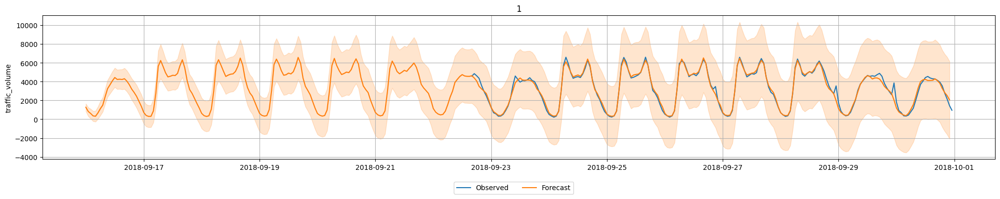

In [71]:
import matplotlib.pyplot as plt


# Plot 4 randomly chosen time series and the respective forecasts
predictor.plot(df_test_autogluon, predictions, quantile_levels=[0.1, 0.9], max_history_length=200, max_num_item_ids=4);

In [82]:
df_test_autogluon_tmp = df_test_autogluon.loc[:8725]

In [83]:
mae_autogluon = mean_absolute_error(df_test_autogluon_tmp['traffic_volume'], predictions['mean'])
rmse_autogluon = np.sqrt(mean_squared_error(df_test_autogluon_tmp['traffic_volume'], predictions['mean']))
print(f'Mean Absolute Error: {mae_autogluon:.2f}');
print(f'Root Mean Squared Error: {rmse_autogluon:.2f}');

Mean Absolute Error: 182.89
Root Mean Squared Error: 272.16


### 2.9. Предсказание по температуре

In [94]:
df_auto_gluon_temp = df_full_ready.loc['2017-10-02 09:00:00':'2018-09-30 23:00:00']

df_auto_gluon_temp.drop(columns =['hour', 'holiday',  'weekday'], inplace=True)


In [95]:
df_auto_gluon_temp["item_id"] = 1

In [77]:
df_auto_gluon_temp

,temp,item_id
2017-10-02 09:00:00,286.75,1
2017-10-02 10:00:00,287.86,1
2017-10-02 11:00:00,289.93,1
2017-10-02 12:00:00,290.57,1
2017-10-02 13:00:00,291.48,1
...,...,...
2018-09-30 19:00:00,283.45,1
2018-09-30 20:00:00,282.76,1
2018-09-30 21:00:00,282.73,1
2018-09-30 22:00:00,282.09,1


In [96]:
df_auto_gluon_temp['timestamp'] = df_auto_gluon_temp.index
df_auto_gluon_temp.reset_index(inplace=True)
df_auto_gluon_temp.drop(columns =['index'], inplace=True)

df_auto_gluon_temp['timestamp'] = pd.to_datetime(df_auto_gluon_temp['timestamp'])


df_train_autogluon_temp = df_auto_gluon_temp.loc[:8366]
df_test_autogluon_temp = df_auto_gluon_temp.loc[8367:]

In [97]:
df_train_autogluon_temp

,temp,traffic_volume,item_id,timestamp
0,286.75,5018.0,1,2017-10-02 09:00:00
1,287.86,4342.0,1,2017-10-02 10:00:00
2,289.93,4519.0,1,2017-10-02 11:00:00
3,290.57,4683.0,1,2017-10-02 12:00:00
4,291.48,4670.0,1,2017-10-02 13:00:00
...,...,...,...,...
8362,304.47,3455.0,1,2018-09-15 19:00:00
8363,301.34,3208.0,1,2018-09-15 20:00:00
8364,299.26,3055.0,1,2018-09-15 21:00:00
8365,298.21,2741.0,1,2018-09-15 22:00:00


In [102]:
df_test_autogluon_temp

,temp,traffic_volume,item_id,timestamp
8367,297.57,1353.0,1,2018-09-16 00:00:00
8368,297.11,786.0,1,2018-09-16 01:00:00
8369,296.77,607.0,1,2018-09-16 02:00:00
8370,296.42,401.0,1,2018-09-16 03:00:00
8371,295.83,313.0,1,2018-09-16 04:00:00
...,...,...,...,...
8722,283.45,3543.0,1,2018-09-30 19:00:00
8723,282.76,2781.0,1,2018-09-30 20:00:00
8724,282.73,2159.0,1,2018-09-30 21:00:00
8725,282.09,1450.0,1,2018-09-30 22:00:00


In [107]:
predictor_temp = TimeSeriesPredictor(
    prediction_length=359,
    path="autogluon-m4-hourly",
    target="temp",
    eval_metric="MASE",
    freq='h'
)

predictor_temp.fit(
    df_train_autogluon_temp,
    presets="medium_quality",
    time_limit=600,
)

Beginning AutoGluon training... Time limit = 600s
AutoGluon will save models to '/content/autogluon-m4-hourly'
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.11.11
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
GPU Count:          0
Memory Avail:       9.46 GB / 12.67 GB (74.6%)
Disk Space Avail:   68.75 GB / 107.72 GB (63.8%)
Setting presets to: medium_quality

Fitting with arguments:
{'enable_ensemble': True,
 'eval_metric': MASE,
 'freq': 'h',
 'hyperparameters': 'light',
 'known_covariates_names': [],
 'num_val_windows': 1,
 'prediction_length': 359,
 'quantile_levels': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9],
 'random_seed': 123,
 'refit_every_n_windows': 1,
 'refit_full': False,
 'skip_model_selection': False,
 'target': 'temp',
 'time_limit': 600,
 'verbosity': 2}

Provided train_data has 8367 rows, 1 time series. Median tim

In [108]:
predicted_df = predictor_temp.predict(df_train_autogluon_temp, model='WeightedEnsemble')



In [105]:
predicted_df

mean         0.1         0.2         0.3  \
item_id timestamp                                                             
1       2018-09-16 00:00:00  297.297782  296.445878  296.727680  296.931130   
        2018-09-16 01:00:00  296.729732  295.535930  295.943331  296.237919   
        2018-09-16 02:00:00  296.433423  294.954341  295.460652  295.812157   
        2018-09-16 03:00:00  296.133480  294.524490  295.049126  295.481073   
        2018-09-16 04:00:00  295.788820  293.947553  294.558176  295.029807   
...                                 ...         ...         ...         ...   
        2018-09-30 19:00:00  311.261652  295.465035  300.569739  304.501569   
        2018-09-30 20:00:00  309.070923  293.183105  298.425520  302.342298   
        2018-09-30 21:00:00  307.421377  291.455033  296.786931  300.704602   
        2018-09-30 22:00:00  306.733252  290.800197  295.929850  299.860854   
        2018-09-30 23:00:00  306.180734  290.220597  295.381597  299.327068   

                                    0.4         0.5         0.6         0.7  \
item_id timestamp                                                             
1       2018-09-16 00:00:00  297.124849  297.297782  297.474086  297.654100   
        2018-09-16 01:00:00  296.493159  296.729732  296.958801  297.220762   
        2018-09-16 02:00:00  296.144415  296.433423  296.741949  297.052759   
        2018-09-16 03:00:00  295.817576  296.133480  296.489667  296.873225   
        2018-09-16 04:00:00  295.420750  295.788820  296.170527  296.589570   
...                                 ...         ...         ...         ...   
        2018-09-30 19:00:00  308.324259  311.261652  314.121412  317.486870   
        2018-09-30 20:00:00  306.087372  309.070923  312.052876  315.264414   
        2018-09-30 21:00:00  304.408488  307.421377  310.419302  313.526441   
        2018-09-30 22:00:00  303.588962  306.733252  309.684552  312.784225   
        2018-09-30 23:00:00  303.021412  306.180734  309.085640  312.241381   

                                    0.8         0.9  
item_id timestamp                                    
1       2018-09-16 00:00:00  297.862206  298.169246  
        2018-09-16 01:00:00  297.527618  297.951915  
        2018-09-16 02:00:00  297.422836  297.929874  
        2018-09-16 03:00:00  297.279581  297.840287  
        2018-09-16 04:00:00  297.037473  297.721234  
...                                 ...         ...  
        2018-09-30 19:00:00  321.212489  326.647697  
        2018-09-30 20:00:00  319.089610  324.393124  
        2018-09-30 21:00:00  317.506798  322.839565  
        2018-09-30 22:00:00  316.598293  322.008925  
        2018-09-30 23:00:00  316.054409  321.418159  

[360 rows x 10 columns]

In [44]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_train_auto_arima['data_time'], y=df_train_auto_arima['traffic_volume'], name='Train'))
fig.add_trace(go.Scatter(x=df_test_autogluon_temp['timestamp'], y=df_test_autogluon_temp['temp'], name='Test'))
fig.add_trace(go.Scatter(x=predicted_df['timestamp'], y=predicted_df['mean'], name='Forecast'))
fig.update_layout(template="simple_white", font=dict(size=18), title_text='',
                      width=1150, title_x=0.5, height=800, xaxis_title='Date',
                      yaxis_title='tempreture')

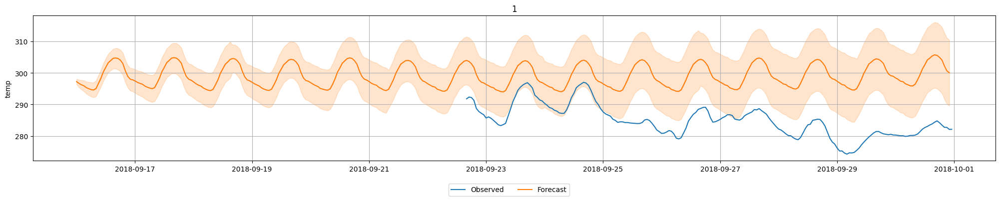

In [89]:
predictor_temp.plot(data=df_test_autogluon_temp,  predictions=predicted_df, quantile_levels=[0.1, 0.9], max_history_length=200, max_num_item_ids=4);

In [109]:
predictor_temp.leaderboard(df_test_autogluon_temp)

Additional data provided, testing on additional data. Resulting leaderboard will be sorted according to test score (`score_test`).


,model,score_test,score_val,pred_time_test,pred_time_val,fit_time_marginal,fit_order
0,Chronos[bolt_small],-8.991664,-0.864968,1.351283,2.324672,0.025865,7
1,WeightedEnsemble,-9.914589,-0.806627,1.413257,12.910363,0.593056,8
2,Theta,-10.712396,-1.120403,0.034960,0.368257,0.023505,6
3,SeasonalNaive,-10.712396,-1.009515,0.033509,0.089935,0.037100,2
4,RecursiveTabular,-10.712396,-0.835710,0.058704,10.585690,9.839272,3
5,Naive,-10.712396,-1.160656,0.034800,0.058554,0.036802,1
6,ETS,-10.712396,-1.160661,0.036957,1.656563,0.023943,5
7,DirectTabular,-19.646401,-0.936683,0.137756,0.211626,3.269806,4


In [93]:
mae_autogluon_temp = mean_absolute_error(df_test_autogluon_temp['temp'], predicted_df['mean'])
rmse_autogluon_temp = np.sqrt(mean_squared_error(df_test_autogluon_temp['temp'], predicted_df['mean']))
print(f'Mean Absolute Error: {mae_autogluon_temp:.2f}');
print(f'Root Mean Squared Error: {rmse_autogluon_temp:.2f}');

Mean Absolute Error: 17.12
Root Mean Squared Error: 18.95


Сделал прогноз по температуре, только не уверен, что полученный прогноз следует использовать при прогнозировании трафика, т.к. судя по графику не увидел взаимосвязи.


## Вывод

Модели:

1) SARIMAX
параметры
p=49
d=1
q=52
P=0
Q=0
s=168
s=168 получаем 24*7, чтобы учитывать недельную сезонность
Модель зависла, не получил никаких данных.

2) AutoReg

Mean Absolute Error: 1848.36

Root Mean Squared Error: 2279.17

3) AutoARIMA по признакам фурье

Mean Absolute Error: 1937.78

Root Mean Squared Error: 2391.95

4) Nixtla. AutoARIMA
Быстро выравнивает значения, что приводит к искажению резлуьтатов, фактически прогнозируемый график это прямая(кроме нескольких первых дней прогноза)

Mean Absolute Error: 1694.96

Root Mean Squared Error: 1930.67

5) AutoTs

Лучшая модель:
Ensemble

SMAPE: 49.58265679785709, 37.9701944446465, 37.79689683629857
MAE: 1298.5696302256013, 906.6584973917579, 904.5012872448489
SPL: 0.871030034409611, 0.5784616284868439, 0.7142080312978121

Слишком усредненные показатели получили, но основная динамика показана верна

Mean Absolute Error: 1280.37

Root Mean Squared Error: 1473.19


6) AutoGluon
Лучшая модель: WeightedEnsemble score: -0.4936

Mean Absolute Error: 182.89

Root Mean Squared Error: 272.16

В ходе проведенных исследований лучшие метрики показала модель WeightedEnsemble из библиотеки AutoGluon.

Попробовал использовать билиотеку H2O, но выходит ошибка выполнения в python, очень похоже, что python не может корректно обработать ответ от java